## Refine epithelial cell annotations for large intestine - relabelling uncertain cells based on manual inspection/majority voting

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

In [2]:
sc.logging.print_header()

scanpy==1.7.1 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [3]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [4]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=12,
    frameon=False,
    transparent=True,
)

In [5]:
sns.set_style(style="white")
sns.set_context(context="paper")

### Import

In [6]:
#import data
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/compartments/Epi.pooled_disease_with_klennerman_ramnik.log1pcounts.20230221.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 311277 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [8]:
list(adata.obs.organ_unified.unique())

['ileum',
 'caecum',
 'rectum',
 'sigmoid colon',
 'colon',
 'ascending colon',
 'small intestine',
 'stomach',
 'descending colon',
 'transverse',
 'duodenum']

In [9]:
#remove small intestine and stomach samples
adata = adata[~adata.obs.organ_unified.isin(['ileum',
 
 'small intestine',
 'duodenum','stomach'])].copy()

In [10]:
adata

AnnData object with n_obs × n_vars = 116103 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [11]:
#import scanvi coordinates
adata_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/X_scANVI/disease/disease_fine_annot_predict_Epi_LI_adult_method2_20230221_RAMNIK_KLENERMAN_POOLED_scANVIobsm.csv.gz',compression='gzip',index_col=0)

In [12]:
adata_scanvi

,LV1,LV2,LV3,LV4,LV5,LV6,LV7,LV8,LV9,LV10,LV11,LV12,LV13,LV14,LV15,LV16,LV17,LV18,LV19,LV20
index,,,,,,,,,,,,,,,,,,,,
AAACCTGGTCTTTCAT-scrEXT001,0.065063,0.724252,0.532578,0.155425,0.258733,0.026523,-0.077738,-0.935326,-1.340696,-0.135202,-0.040811,-0.024796,-0.259163,0.698904,-0.276099,-0.949262,0.031803,0.103551,0.036461,-1.044813
AAAGATGGTATAGGGC-scrEXT001,0.154588,-2.108576,0.280209,0.129227,0.306066,0.077100,0.006615,-1.240505,-0.149718,-0.044862,-0.099568,-0.109189,-0.457238,-0.699063,-0.372050,2.065342,-0.023132,0.199433,-0.047812,-1.383002
AAAGATGGTGGCCCTA-scrEXT001,0.056376,0.214129,-0.013501,-0.154597,-1.221245,0.073379,-0.004688,-0.412931,0.814335,-0.079035,0.012424,0.016587,-0.363864,-1.328290,-0.203558,1.420984,-0.133768,0.146219,0.109556,0.628151
AAAGCAAGTAAACACA-scrEXT001,0.097532,-1.828027,0.658432,-0.717948,0.120521,0.114009,-0.007134,-1.176004,-0.396808,-0.065709,-0.043744,-0.074637,-0.648605,-0.934625,-0.259891,1.360326,-0.082865,0.191588,0.002960,0.935122
AAAGCAAGTCATCCCT-scrEXT001,0.102058,0.028138,-0.318477,-0.850401,0.177137,0.113123,-0.073851,-2.546045,-1.715626,-0.182155,-0.085575,-0.130313,0.441536,0.285122,0.715005,-0.925990,0.005639,0.129117,0.042421,-0.525822
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N130084_L-GTGGTTACAGTTCCAA-N130084_L,0.080163,-1.697329,0.532934,-1.315137,1.638868,0.078298,-0.059671,-1.082499,-0.213048,-0.156992,-0.076649,-0.199311,1.700725,2.611239,-1.415647,-0.401982,0.162676,0.119553,0.070581,-1.062000
N130084_L-TATCCTATCGTTCATT-N130084_L,0.029717,-0.653176,-0.696866,-1.318062,0.465558,0.042668,0.025961,-0.087542,-0.058524,-0.059883,0.002429,-0.031932,-0.271525,0.131003,0.694196,0.409602,0.027220,0.062472,0.018969,-0.317243
N130084_L-TCATCCGGTATGATCC-N130084_L,0.014982,-0.786605,1.561810,-0.613374,1.537899,-0.030664,0.007360,-0.113989,-0.518060,-0.038610,0.018819,-0.028353,-0.238676,-0.345852,-0.150165,0.273770,-0.009530,0.042612,0.008016,0.336016


In [13]:
adata.obsm['X_scANVI'] = adata_scanvi

In [14]:
#import metadata
adata_meta = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/disease/20230308/scanvi/disease_fine_annot_predict_Epi_LI_adult_method2_20230221_RAMNIK_KLENERMAN_POOLED.csv',index_col=0)

/home/jovyan/my-conda-envs/standard/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (3,5,6,8,9,11,12,14,64,67,69,76,77,78,89,94,97,99,100,102,103,105,106,107,108,109,110,111,112,113) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [15]:
adata_meta

,latent_cell_probability,latent_RT_efficiency,cecilia22_predH,cecilia22_predH_prob,cecilia22_predH_uncertain,cecilia22_predL,cecilia22_predL_prob,cecilia22_predL_uncertain,elmentaite21_pred,elmentaite21_pred_prob,...,TX_steroid,TX_immunomodulators,TX_antibiotic,Smoking,batch,celltype,fine_annot,fine_predicted_labels,fine_predicted_labels_uncertainty,scanvi_pred
index,,,,,,,,,,,,,,,,,,,,,
AAACCTGGTCTTTCAT-scrEXT001,0.999873,2.794602,Epithelial cells,0.843226,Epithelial cells,Epithelial cells,0.949155,Epithelial cells,BEST2+ Goblet cell,0.968591,...,NaN,NaN,NaN,NaN,0,NaN,Unknown,Doublets,0.540008,TA_cycling
AAAGATGGTATAGGGC-scrEXT001,0.999923,3.364700,Epithelial cells,0.994449,Epithelial cells,Epithelial cells,0.998999,Epithelial cells,Goblet cell,0.247065,...,NaN,NaN,NaN,NaN,0,NaN,Unknown,Epithelial_stem,0.599964,Epithelial_stem
AAAGATGGTGGCCCTA-scrEXT001,0.999929,3.838964,Epithelial cells,0.999978,Epithelial cells,Epithelial cells,0.999997,Epithelial cells,Mesothelium,0.997397,...,NaN,NaN,NaN,NaN,0,NaN,Unknown,Doublets,0.140003,DSC_MUC17
AAAGCAAGTAAACACA-scrEXT001,0.999882,3.473178,Epithelial cells,0.221513,Uncertain,Epithelial cells,0.155091,Uncertain,Goblet cell,0.017632,...,NaN,NaN,NaN,NaN,0,NaN,Unknown,Doublets,0.580034,Epithelial_stem
AAAGCAAGTCATCCCT-scrEXT001,0.999743,1.723092,Epithelial cells,0.117101,Uncertain,Epithelial cells,0.268638,Uncertain,TA,0.154195,...,NaN,NaN,NaN,NaN,0,NaN,Unknown,TA_cycling,0.099997,TA_cycling
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N130084_L-GTGGTTACAGTTCCAA-N130084_L,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,no,no,no,Never,0,NaN,Unknown,Tuft,0.000000,Tuft
N130084_L-TATCCTATCGTTCATT-N130084_L,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,no,no,no,Never,0,NaN,Unknown,Colonocyte,0.040048,Colonocyte
N130084_L-TCATCCGGTATGATCC-N130084_L,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,no,no,no,Never,0,NaN,Unknown,BEST4,0.219959,BEST4


In [16]:
adata.obs = adata_meta

### Process

In [17]:
#compute neighbours and umap
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

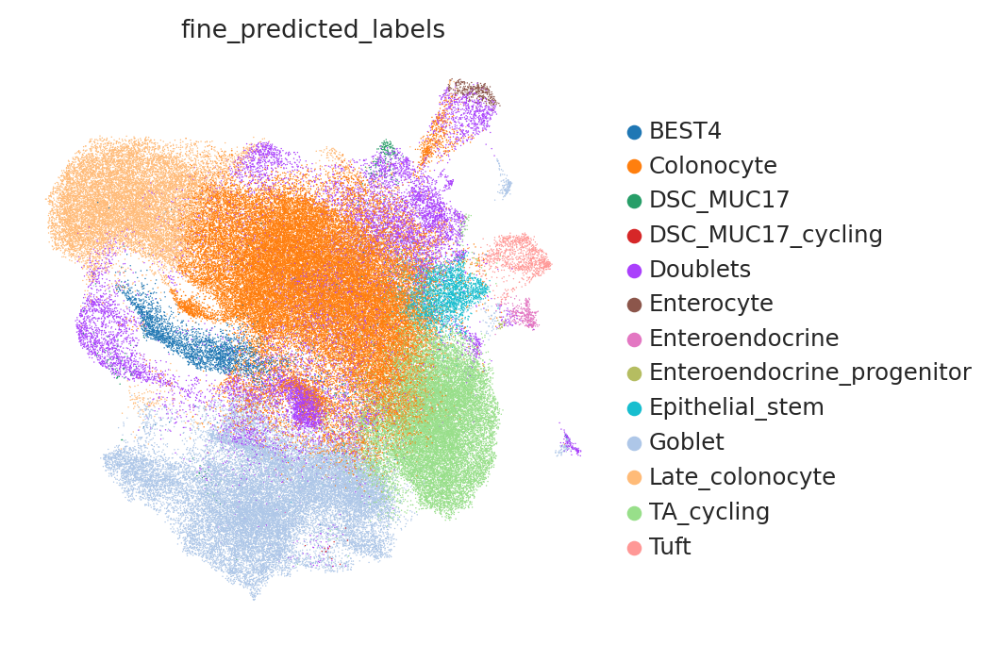

In [18]:
sc.pl.umap(adata, color=['fine_predicted_labels'])

In [19]:
adata.obs.donor_disease.unique()

['cancer', 'UC', 'PIBD', 'CD', 'control']
Categories (5, object): ['cancer', 'UC', 'PIBD', 'CD', 'control']

In [20]:
#fix metadata
adata.obs['disease'] = adata.obs['donor_category'].astype(str) + '_' + adata.obs['donor_disease'].astype(str)

In [21]:
list(adata.obs.disease.unique())

['disease_cancer',
 'disease_UC',
 'disease_PIBD',
 'control_CD',
 'disease_CD',
 'control_control']

In [22]:
adata.obs['donor_disease'] = (adata.obs['disease'].map(lambda x:{
'control_control':'control',
 'control_CD':'CD',
 'disease_PIBD':'PIBD',
 'disease_cancer':'cancer_colorectal',
 'disease_CD':'CD',
'disease_UC':'UC'
    
    }.get(x,x)).astype("category"))

In [23]:
adata.obs.donor_disease.unique()

['cancer_colorectal', 'UC', 'PIBD', 'CD', 'control']
Categories (5, object): ['cancer_colorectal', 'UC', 'PIBD', 'CD', 'control']

In [24]:
adata.obs['disease'] = (adata.obs['disease'].map(lambda x:{
'disease_cancer':'cancer_colorectal',
 'disease_UC':'ulcerative_colitis',
 'disease_PIBD':'pediatric_IBD',
 'control_CD':'crohns_noninflammed',
 'disease_CD':'crohns_disease',
 'control_control':'control'
    }.get(x,x)).astype("category"))

In [25]:
list(adata.obs.disease.unique())

['cancer_colorectal',
 'ulcerative_colitis',
 'pediatric_IBD',
 'crohns_noninflammed',
 'crohns_disease',
 'control']

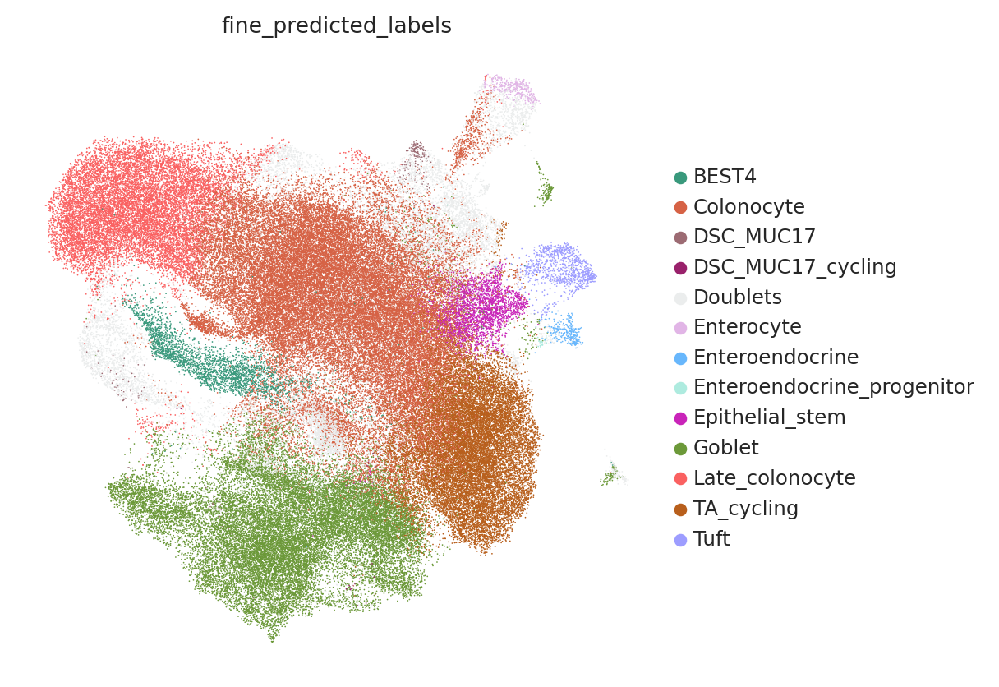

In [26]:
#plot umaps
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels',palette = ['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                 '#ebeded',#doublets
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               #'#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
                                               
                                               
    
    
                                              ],size=1.5)

In [27]:
adata.obs['organ_unified'].cat.categories

Index(['ascending colon', 'caecum', 'colon', 'descending colon', 'rectum',
       'sigmoid colon', 'transverse'],
      dtype='object')

In [28]:
adata.obs['organ_unified'].cat.reorder_categories(['caecum', 'ascending colon','transverse', 'descending colon', 'sigmoid colon', 'rectum','colon'], inplace=True)

In [29]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi=150,dpi_save=300)

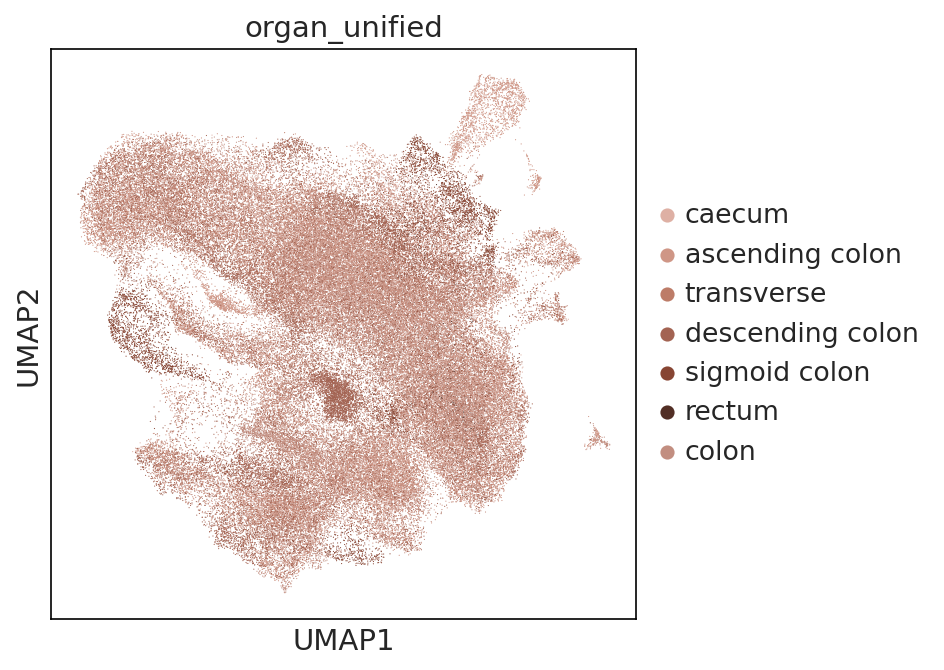

In [30]:
c_organs_unified = [
     
    '#deb0a4',#ceacum
     '#cf9686',#ascending colon
     '#bd7c68',#transverse
     '#a36352',#descending
     '#874533', #sigmoid
     '#522e25',#rectum
     '#c28e80',#colon
    ]
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color='organ_unified',palette=c_organs_unified,size=1.2)

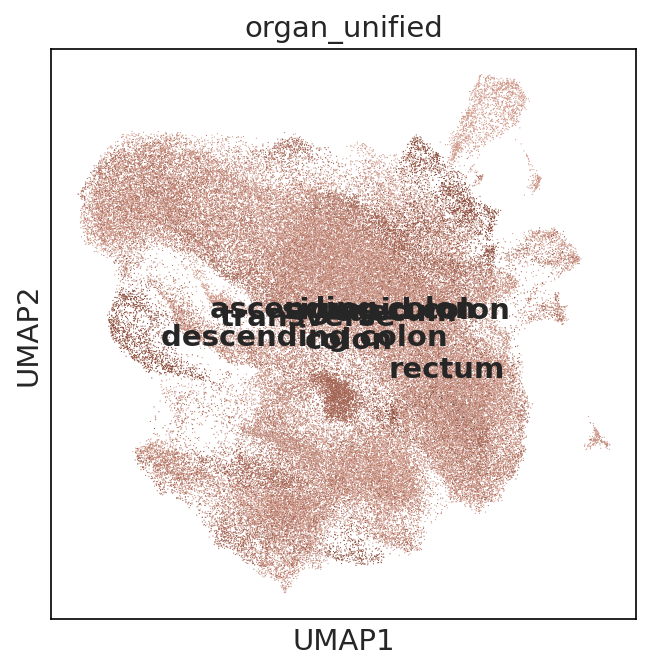

In [31]:
sc.pl.umap(adata, color='organ_unified',palette=c_organs_unified,size=1.2,legend_loc='on data')

In [33]:
adata

AnnData object with n_obs × n_vars = 116103 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [34]:
del adata.uns['organ_unified_colors']

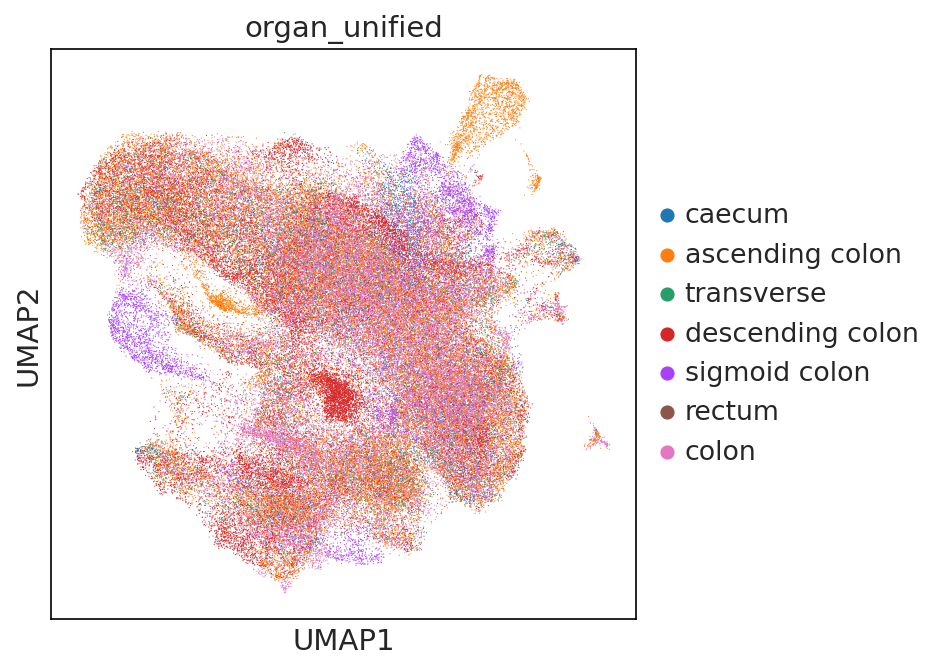

In [35]:
sc.pl.umap(adata, color='organ_unified',size=1.2)

In [31]:
adata.obs['disease'].cat.categories

Index(['cancer_colorectal', 'control', 'crohns_disease', 'crohns_noninflammed',
       'pediatric_IBD', 'ulcerative_colitis'],
      dtype='object')

In [32]:
adata.obs['disease'].cat.reorder_categories(['control', 'crohns_disease', 'crohns_noninflammed',
       'pediatric_IBD', 'ulcerative_colitis','cancer_colorectal',], inplace=True)

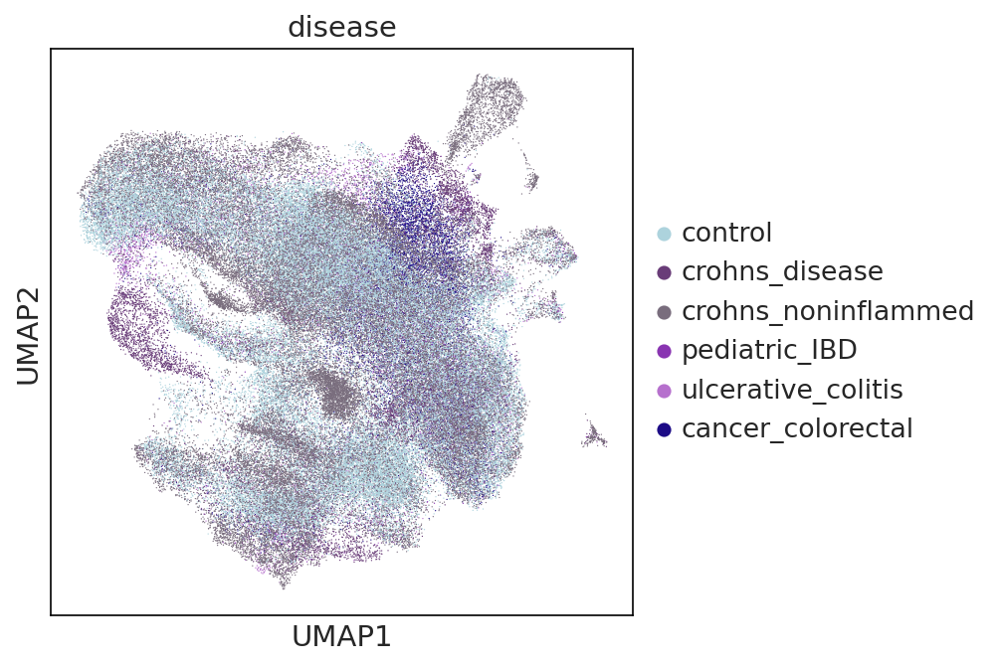

In [33]:
sc.pl.umap(adata,color = 'disease',palette=['#ADD3DD',#control
                                    '#693C78',#crohn's disease
                                            '#796d7d',#crohns noninflammed
                                            '#8934B1',#UC
                                            '#B670CD',#PIBD
                                            '#1C0B86',#colorectal cancer
                                            #'#38B257',#celiac_active
                                            #'#85C762',#celiac_inactive
                                           ],size=1.5,save='pooled_healthy_SI_disease.png')

In [34]:
adata.layers['counts'] = adata.X

In [35]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [36]:
marker_genes_dict = { 'BEST4':['BEST4','CA7','GUCA2B','CFTR'],
                     'Colonocyte':['CA1','GPT'],
                     
                     'DCS_MUC17':['MUC17','TFF1','CD55','TM4SF1','DUOX2','DUOXA2'],
                     'Cycling markers':['MKI67','PCNA','TOP2A'],
                        'Enterocyte':['FABP1','APOA4','PRAP1','PCK1','RBP2','SI'],
                     'Enteroendocrine':['CHGA','PCSK1N','SCT','SCGN','NEUROD1','SOX4'],
                     'Stem':['LGR5','RGMB','ASCL2','OLFM4'],
                     
                     
                     'Goblet':['MUC2','TFF3','FCGBP','ZG16'],
                     'Mature_colonocyte':['SLC26A3','AQP8','CEACAM7'],
                      #'MUC5AC':['MUC5AC','GKN2'],
                     #'MUC6':['MUC6','AQP5','BPIFB1','PGC'],
                    # 'Microfold':['IL2RG','ICAM2','CCL20','CCL23'],
                     'Paneth':['DEFA6','DEFA5','REG3A','PLA2G2A'],
                     
                     'Tuft':['SH2D6','LRMP','MATK','HPGDS']
                     }

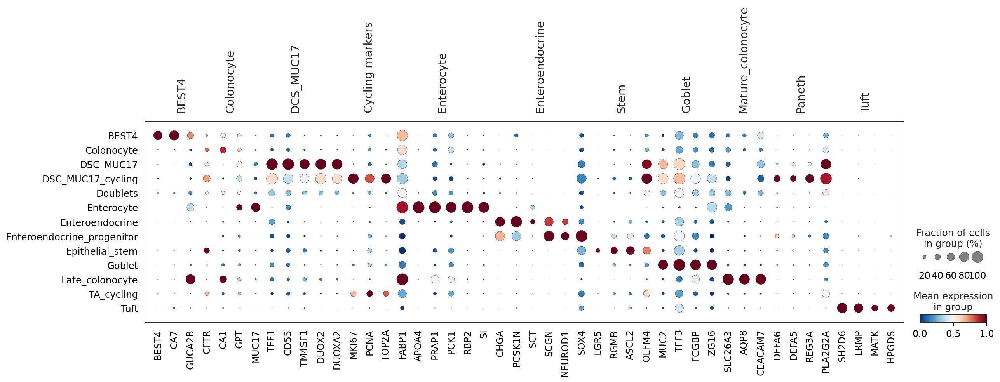

In [37]:
#plot markers
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_predicted_labels',color_map='RdBu_r', standard_scale='var',save='Epi_LI_disease_markers.pdf')

### Define uncertain cells

In [38]:
uncert = adata.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']] 

In [39]:
uncert

,fine_predicted_labels,fine_predicted_labels_uncertainty
index,,
AAACCTGGTCTTTCAT-scrEXT001,Doublets,0.540008
AAAGATGGTATAGGGC-scrEXT001,Epithelial_stem,0.599964
AAAGATGGTGGCCCTA-scrEXT001,Doublets,0.140003
AAAGCAAGTAAACACA-scrEXT001,Doublets,0.580034
AAAGCAAGTCATCCCT-scrEXT001,TA_cycling,0.099997
...,...,...
N130084_L-GTGGTTACAGTTCCAA-N130084_L,Tuft,0.000000
N130084_L-TATCCTATCGTTCATT-N130084_L,Colonocyte,0.040048
N130084_L-TCATCCGGTATGATCC-N130084_L,BEST4,0.219959


In [40]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(adata.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.46001356934255966


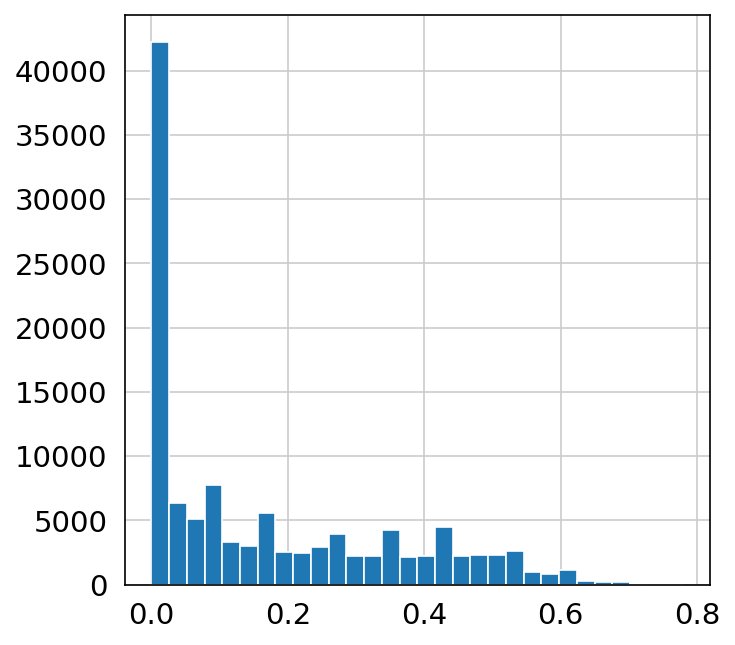

In [41]:
#plot uncertainty distribution
#Extended data 5a
plt.hist(adata.obs['fine_predicted_labels_uncertainty'], bins=30)
plt.savefig('Epi_LI_histogram_uncert.pdf', dpi=300)

In [42]:
uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-42-905f2ed234d6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')


#### make a different cut off for cancer vs noncancer

In [43]:
adata.obs['disease'].unique()

['cancer_colorectal', 'ulcerative_colitis', 'pediatric_IBD', 'crohns_noninflammed', 'crohns_disease', 'control']
Categories (6, object): ['cancer_colorectal', 'ulcerative_colitis', 'pediatric_IBD', 'crohns_noninflammed', 'crohns_disease', 'control']

In [44]:
cancer = adata[adata.obs['disease'].isin(['cancer_colorectal'])].copy()

In [45]:
noncancer = adata[~adata.obs['disease'].isin(['cancer_colorectal'])].copy()

In [46]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(cancer.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.5200127722334565


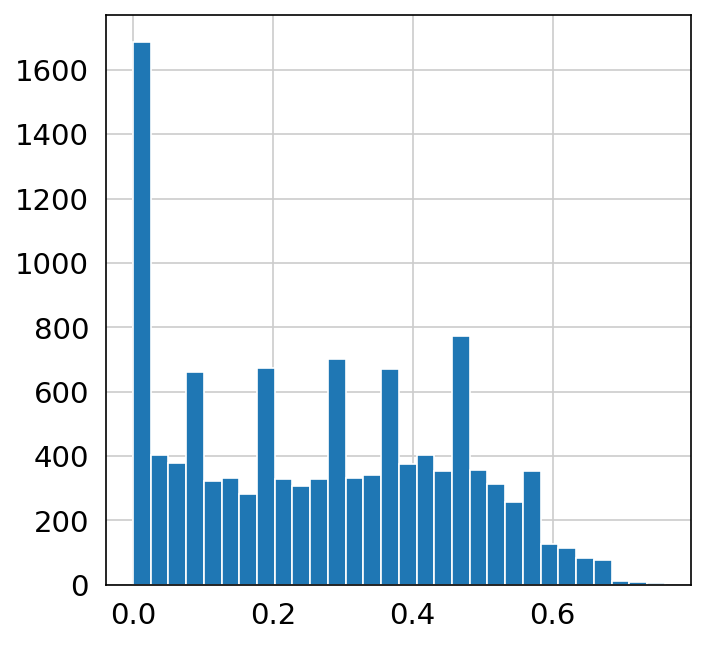

In [47]:
#plot uncertainty distribution
#Extended data 5a
plt.hist(cancer.obs['fine_predicted_labels_uncertainty'], bins=30)
plt.savefig('Epi_LI_histogram_uncert_cellsfromcancer.pdf', dpi=300)

In [48]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(noncancer.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.4599415282007799


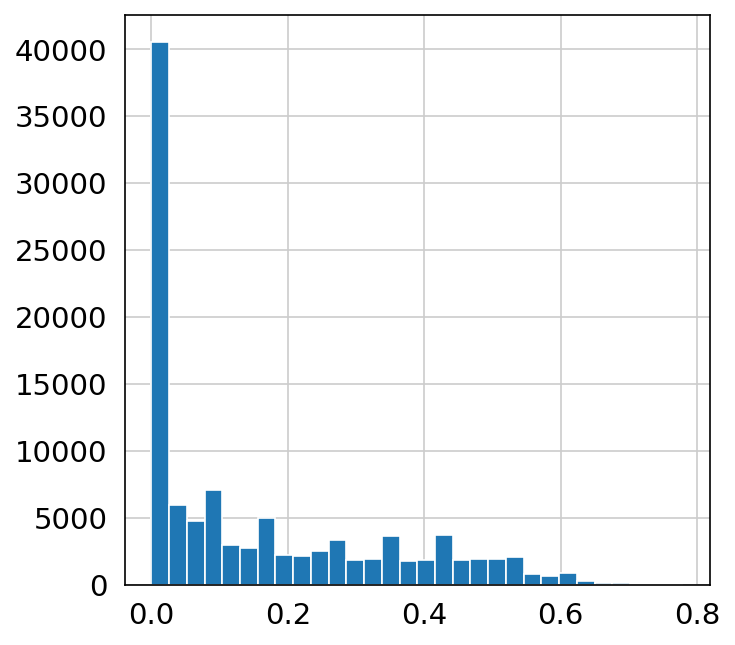

In [49]:
#plot uncertainty distribution
plt.hist(noncancer.obs['fine_predicted_labels_uncertainty'], bins=30)
plt.savefig('Epi_LI_histogram_uncert_notcancer.pdf', dpi=300)

In [50]:
uncert_cancer = cancer.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']]
uncert_other = noncancer.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']]

In [51]:
uncert_cancer['fine_predicted_labels'] = uncert_cancer['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-51-fe174e31fe34>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert_cancer['fine_predicted_labels'] = uncert_cancer['fine_predicted_labels'].cat.add_categories('Unknown')


In [52]:
uncert_other['fine_predicted_labels'] = uncert_other['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-52-71865c2852cd>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert_other['fine_predicted_labels'] = uncert_other['fine_predicted_labels'].cat.add_categories('Unknown')


In [53]:
#mark cells are unknown based on cut off of 90th percentile for cancer samples
uncert_cancer.loc[uncert_cancer["fine_predicted_labels_uncertainty"] > 0.52, "fine_predicted_labels"] = "Unknown"

/home/jovyan/my-conda-envs/standard/lib/python3.8/site-packages/pandas/core/indexing.py:1720: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [54]:
#mark cells are unknown based on cut off of 90th percentile for noncancer samples
uncert_other.loc[uncert_other["fine_predicted_labels_uncertainty"] > 0.46, "fine_predicted_labels"] = "Unknown"

/home/jovyan/my-conda-envs/standard/lib/python3.8/site-packages/pandas/core/indexing.py:1720: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [55]:
uncert_cancer['fine_predicted_labels'].value_counts()

Colonocyte           4294
Doublets             2332
TA_cycling           2072
Unknown              1180
Goblet                614
Late_colonocyte       476
Epithelial_stem       279
BEST4                  56
Tuft                   29
DSC_MUC17              26
DSC_MUC17_cycling       2
Enteroendocrine         2
Name: fine_predicted_labels, dtype: int64

In [56]:
uncert_other['fine_predicted_labels'].value_counts()

Colonocyte                    33343
Goblet                        21001
TA_cycling                    13521
Late_colonocyte               12027
Unknown                        9702
Doublets                       9216
BEST4                          2443
Epithelial_stem                1802
Tuft                            910
Enterocyte                      299
Enteroendocrine                 285
DSC_MUC17                       169
Enteroendocrine_progenitor       17
DSC_MUC17_cycling                 6
Name: fine_predicted_labels, dtype: int64

In [57]:
adata.obs['fine_predicted_labels_uncertflagged'] = adata.obs['fine_predicted_labels']

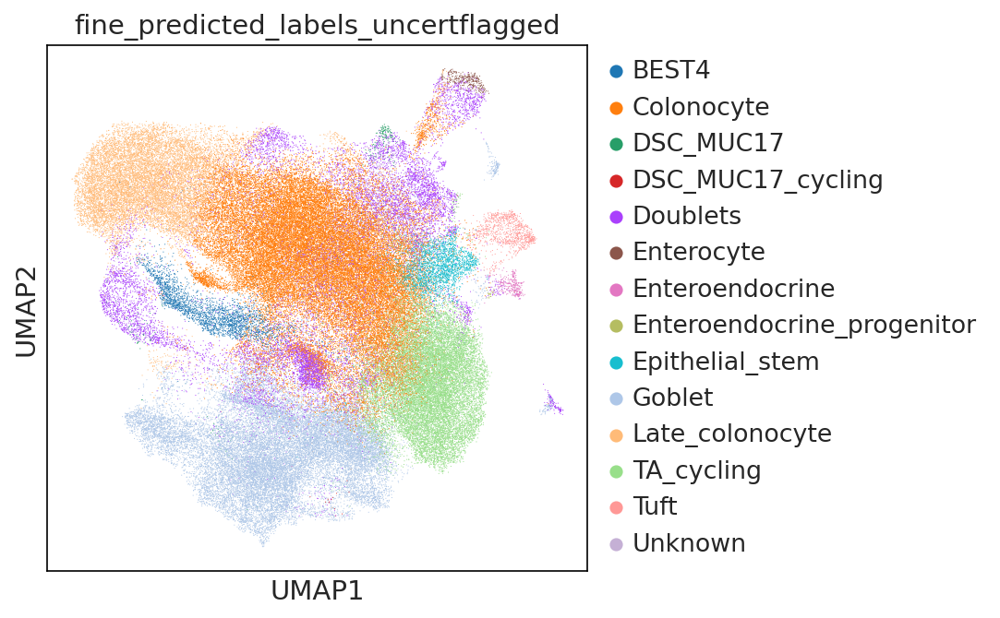

In [58]:
ON = {O:N for O,N in zip(uncert_cancer.index,uncert_cancer["fine_predicted_labels"])}
adata.obs["fine_predicted_labels_uncertflagged"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged')

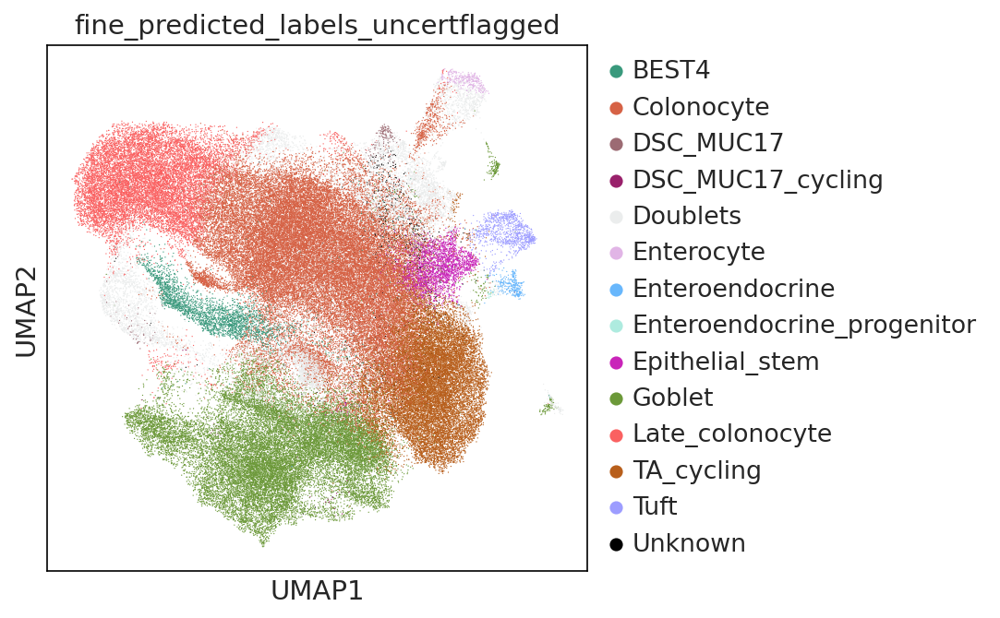

In [59]:
#Extended data 5b
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',palette = ['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                 '#ebeded',#doublets
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               #'#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
                                                          '#000000',#unknown
                                               
                                               
    
    
                                              ],size=1.5,save='Epi_LI_disease_UMAP_uncertflagged.png')

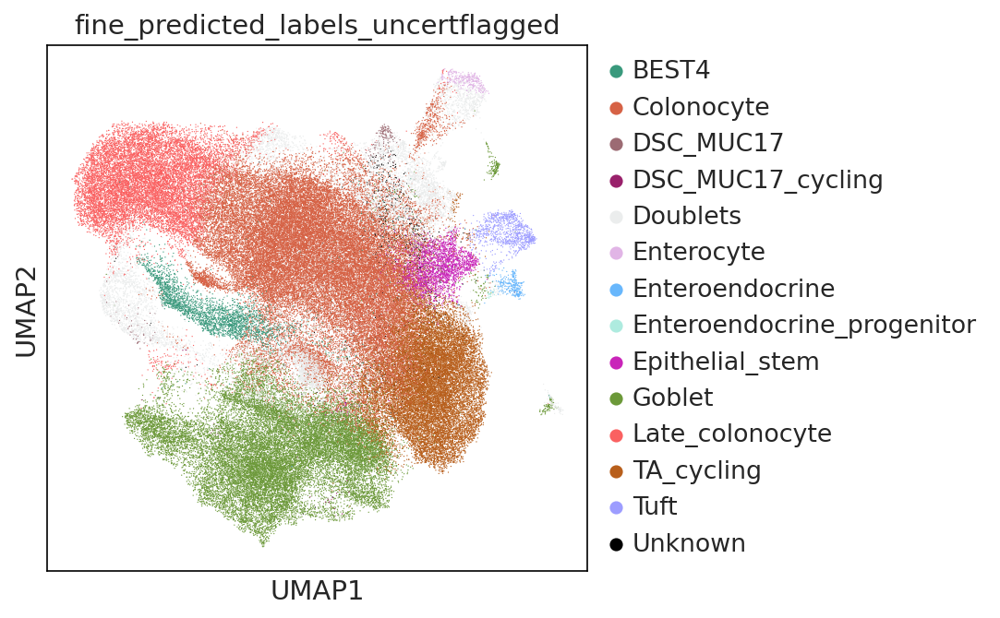

In [60]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',palette = ['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                 '#ebeded',#doublets
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               #'#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
                                                          '#000000',#unknown
                                               
                                               
    
    
                                              ],size=1.5,save='Epi_LI_disease_UMAP_uncertflagged.pdf')

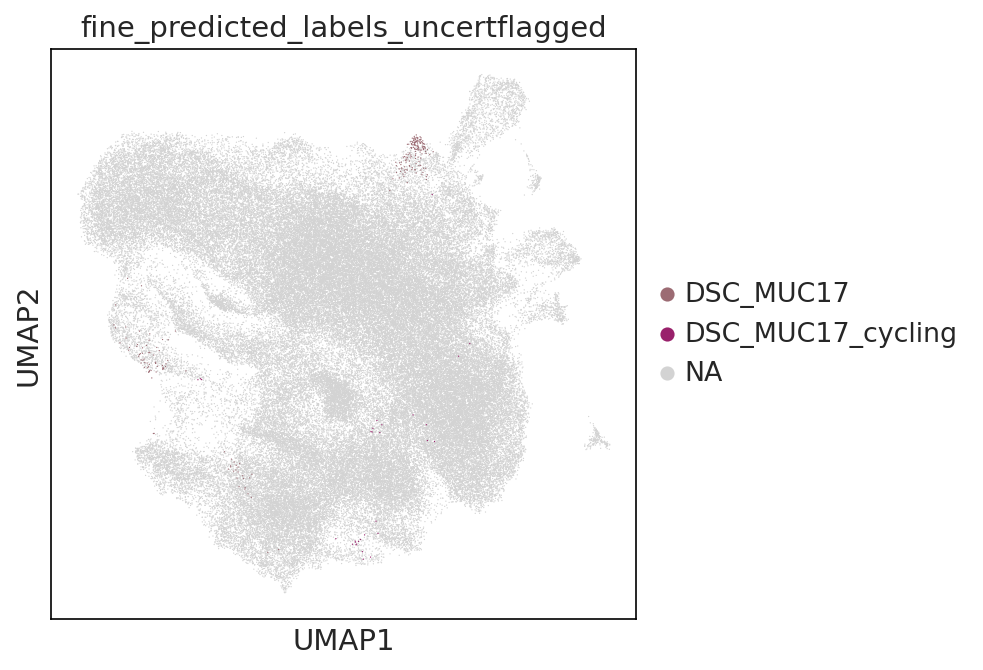

In [61]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',groups=['DSC_MUC17','DSC_MUC17_cycling'],size=1.5)

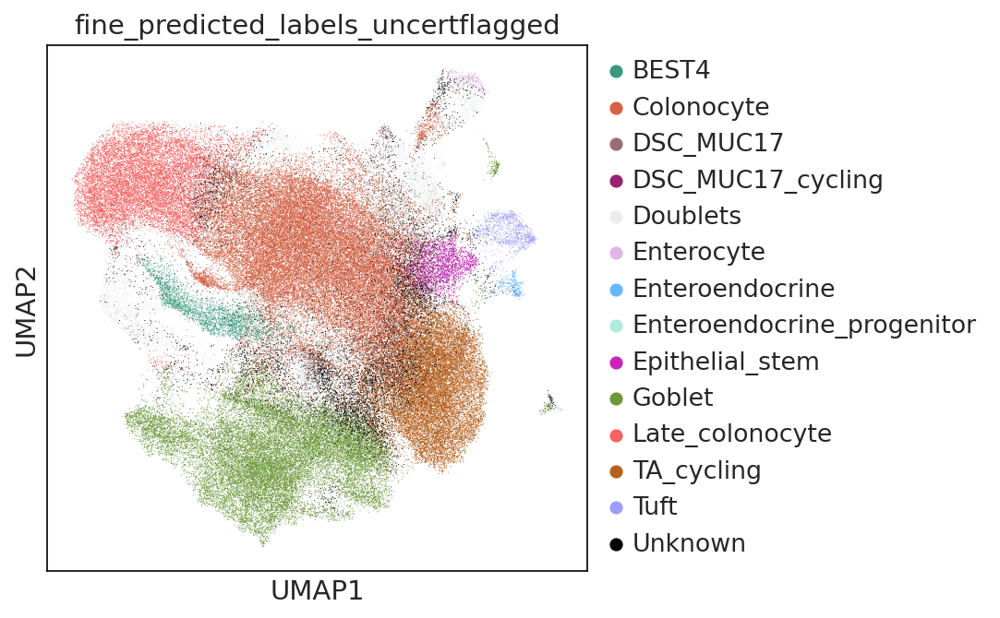

In [62]:
ON = {O:N for O,N in zip(uncert_other.index,uncert_other["fine_predicted_labels"])}
adata.obs["fine_predicted_labels_uncertflagged"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',save='Epi_LI_disease_UMAP_uncertflagged.pdf')

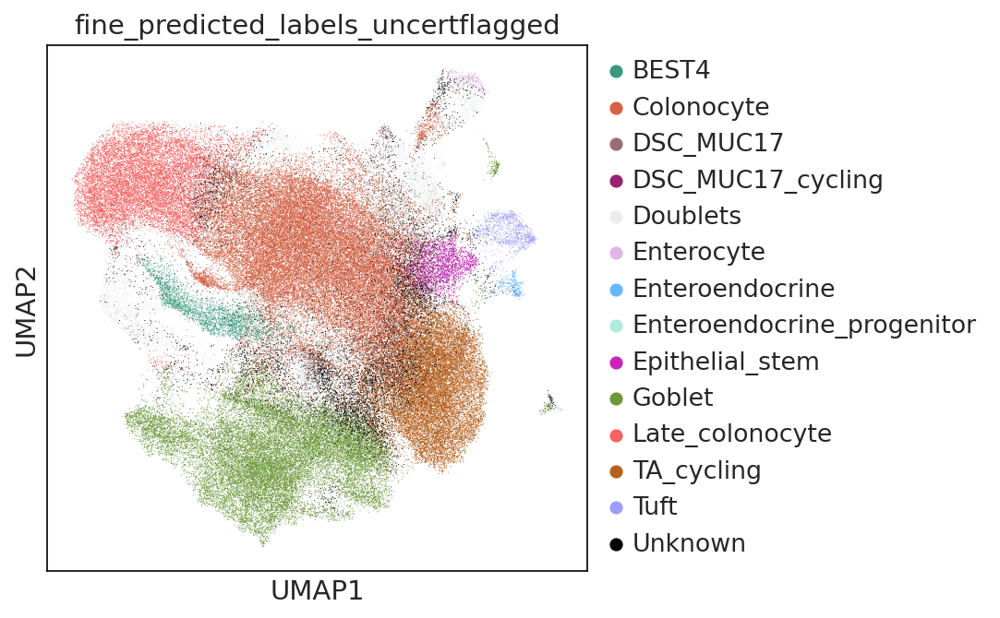

In [63]:
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',save='Epi_LI_disease_UMAP_uncertflagged.png')

In [64]:
adata.obs.disease.cat.categories

Index(['control', 'crohns_disease', 'crohns_noninflammed', 'pediatric_IBD',
       'ulcerative_colitis', 'cancer_colorectal'],
      dtype='object')

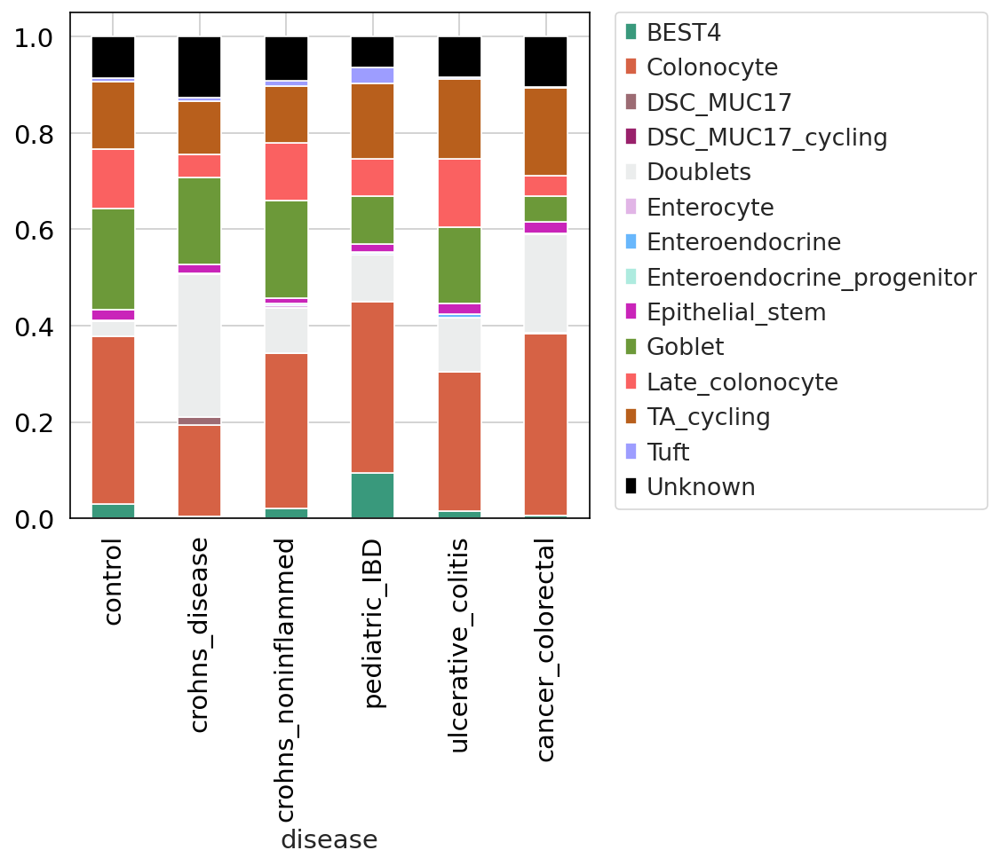

In [65]:
#Extended data 5c
tmp = pd.crosstab(adata.obs['disease'], adata.obs['fine_predicted_labels_uncertflagged'],normalize='index'
                                                                         )
ax = tmp.plot.bar(stacked=True,color=['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                 '#ebeded',#doublets
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               #'#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
                                                          '#000000',#unknown
                                                                         ])
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

plt.savefig("Epi_LI_disease_celltypes_uncert_per_disease.pdf", dpi=300, bbox_inches='tight')

### Finalise annotations
- calculate leiden clusters
- inspect annotations across leiden clusters
- assess marker genes, doublet markers, donor distribution
- relabel based on majority voting of leiden clusters, along with confirmation from marker genes etc.

In [66]:
#reassign labels for unknown cells by leiden clustering and majority voting
sc.tl.leiden(adata,resolution=1,key_added='leiden1')

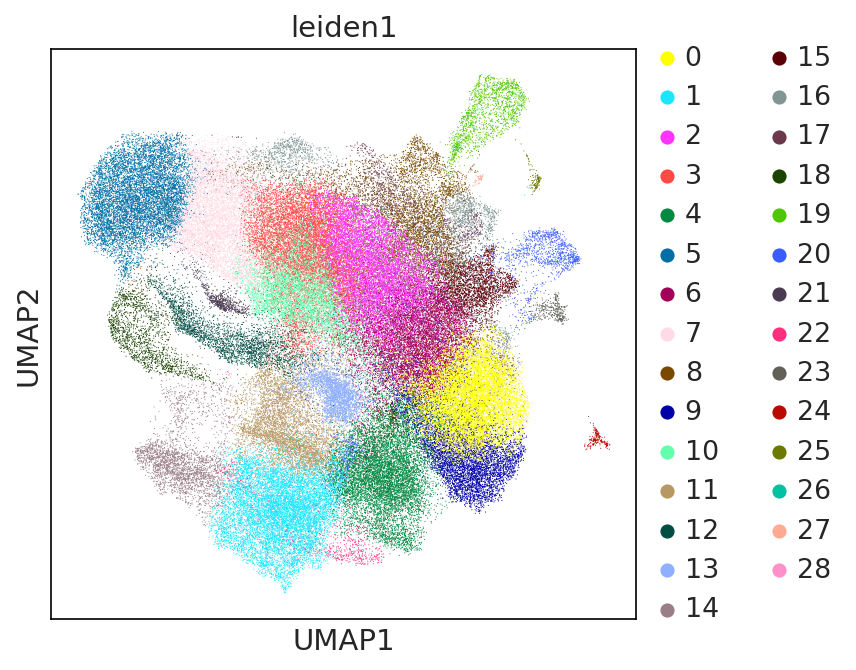

In [67]:
#Extended data 5d
sc.pl.umap(adata,color='leiden1')

In [68]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Colonocyte,DSC_MUC17,DSC_MUC17_cycling,Doublets,Enterocyte,Enteroendocrine,Enteroendocrine_progenitor,Epithelial_stem,Goblet,Late_colonocyte,TA_cycling,Tuft,Unknown
leiden1,,,,,,,,,,,,,,
0,0,804,0,0,54,0,0,0,8,1,0,8460,0,788
1,0,21,0,0,50,0,0,0,1,9749,0,0,0,73
2,2,8952,0,0,201,0,0,0,39,0,0,48,0,334
3,3,8594,0,0,353,0,0,0,0,0,9,0,0,200
4,1,398,0,0,205,0,0,0,0,5398,0,824,0,1789
5,5,0,0,0,171,0,0,0,0,0,8307,0,0,76
6,0,5014,0,0,511,0,0,0,225,26,0,687,0,1650
7,3,2166,0,0,116,0,0,0,0,0,3560,0,0,626
8,7,1675,138,1,3038,0,0,0,28,71,49,7,0,918


In [69]:
#Use Leiden resolution 1
unknown = adata.obs[['leiden1','fine_predicted_labels_uncertflagged']]

In [70]:
unknown = unknown[unknown['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [71]:
unknown

,leiden1,fine_predicted_labels_uncertflagged
index,,
AAACCTGGTCTTTCAT-scrEXT001,4,Unknown
AAAGATGGTATAGGGC-scrEXT001,8,Unknown
AAAGCAAGTAAACACA-scrEXT001,6,Unknown
AAATGCCCACAGTCGC-scrEXT001,8,Unknown
AAATGCCTCAAACCAC-scrEXT001,16,Unknown
...,...,...
N130084_L-TCTTAGTAGATCCCAT-N130084_L,2,Unknown
N130084_L-GTCGTAAGTAGCGTCC-N130084_L,12,Unknown
N130084_L-CGGAGAATCTCTTGCG-N130084_L,6,Unknown


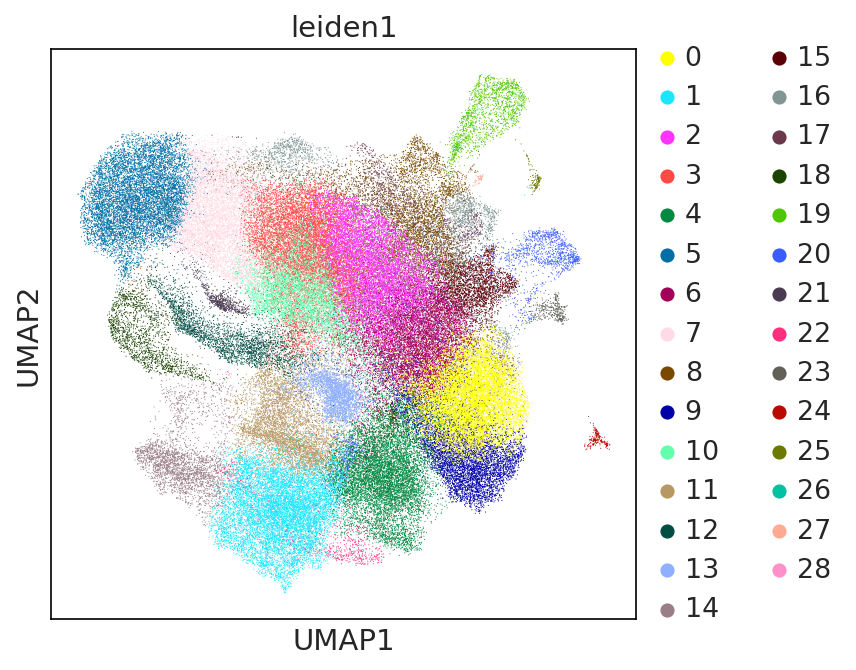

In [72]:
sc.pl.umap(adata,color='leiden1',save='Epi_LI_disease_leiden_reannotation.pdf')

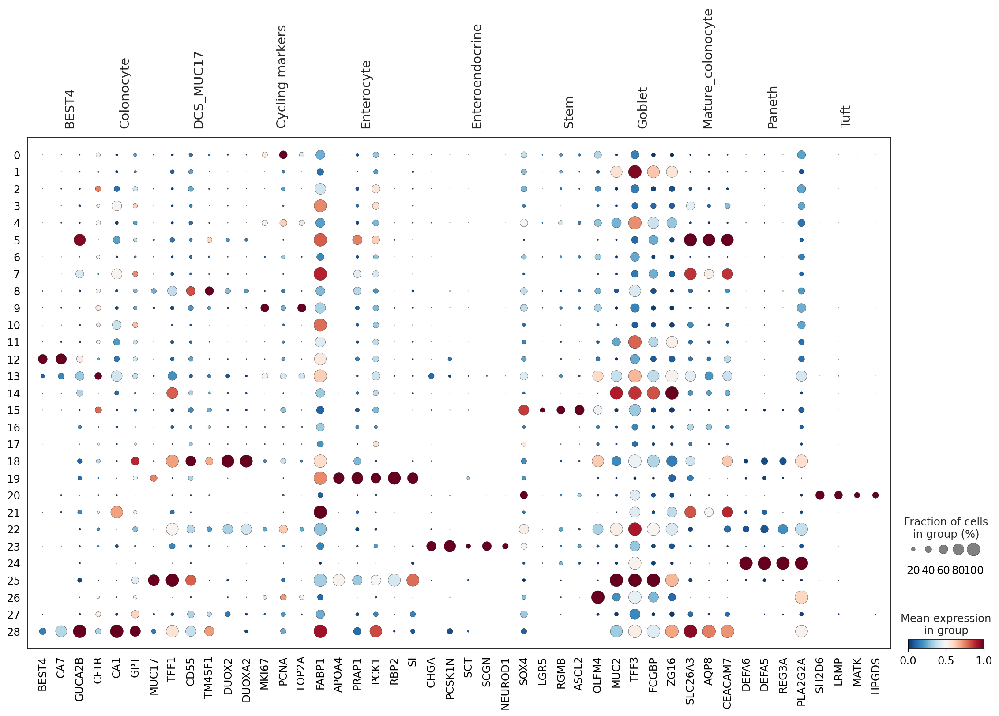

In [73]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var',save='Epi_LI_disease_leiden_reannotationmarkergenedotplot.pdf')

In [74]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Colonocyte,DSC_MUC17,DSC_MUC17_cycling,Doublets,Enterocyte,Enteroendocrine,Enteroendocrine_progenitor,Epithelial_stem,Goblet,Late_colonocyte,TA_cycling,Tuft,Unknown
leiden1,,,,,,,,,,,,,,
0,0,804,0,0,54,0,0,0,8,1,0,8460,0,788
1,0,21,0,0,50,0,0,0,1,9749,0,0,0,73
2,2,8952,0,0,201,0,0,0,39,0,0,48,0,334
3,3,8594,0,0,353,0,0,0,0,0,9,0,0,200
4,1,398,0,0,205,0,0,0,0,5398,0,824,0,1789
5,5,0,0,0,171,0,0,0,0,0,8307,0,0,76
6,0,5014,0,0,511,0,0,0,225,26,0,687,0,1650
7,3,2166,0,0,116,0,0,0,0,0,3560,0,0,626
8,7,1675,138,1,3038,0,0,0,28,71,49,7,0,918


In [75]:
unknown_adata = adata[adata.obs['fine_predicted_labels_uncertflagged'].isin(['Unknown'])].copy()

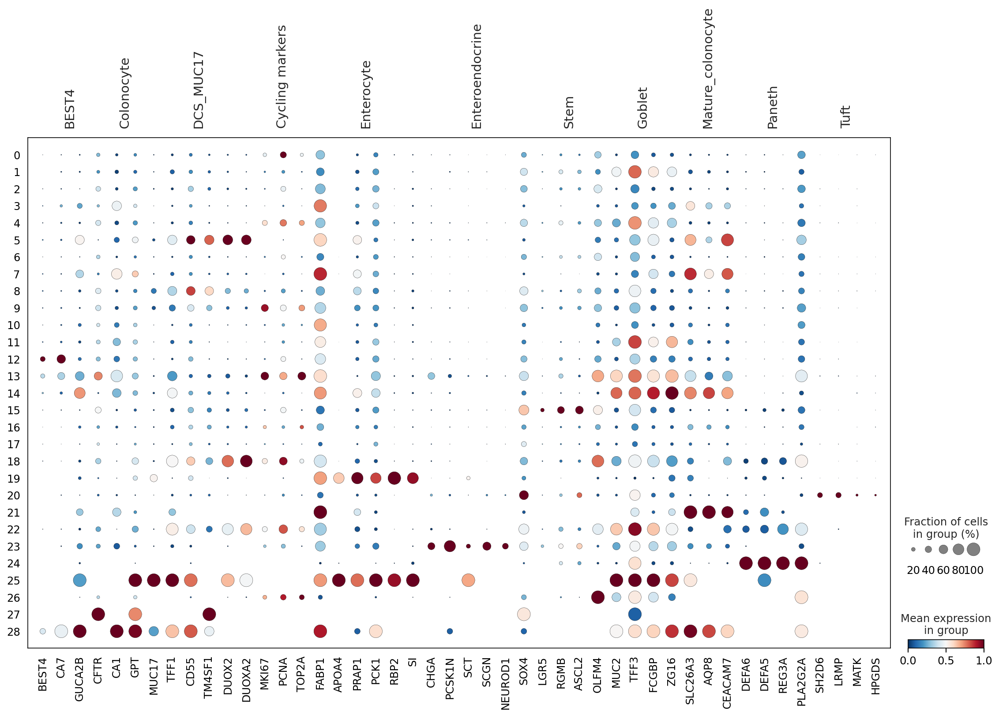

In [76]:
#Extended data 5f
sc.pl.dotplot(unknown_adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var',save='Epi_LI_disease_leiden_reannotationmarkergenedotplot_unknownonly.pdf')

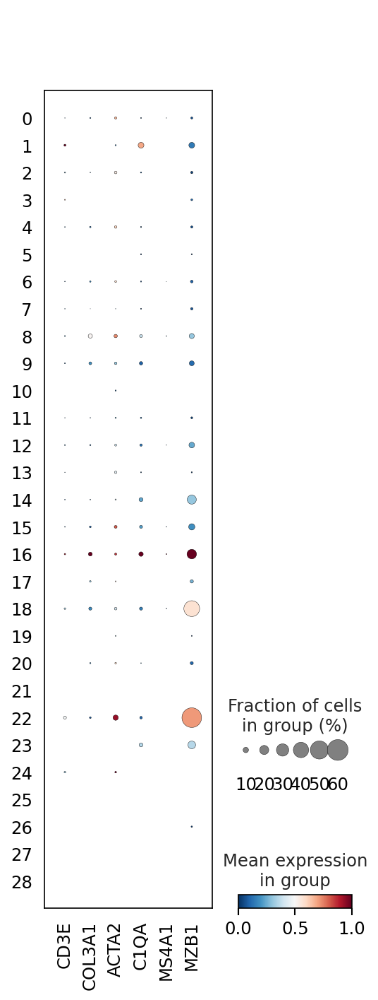

In [77]:
#plot some doublet markers
sc.pl.dotplot(unknown_adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

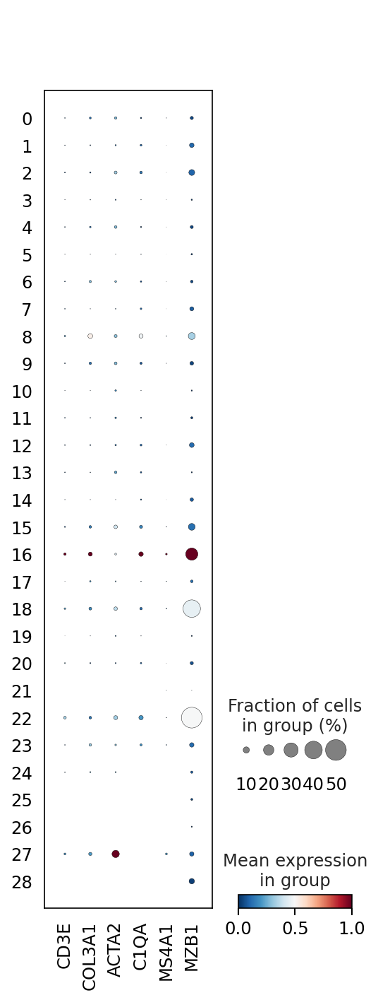

In [78]:
#plot some doublet markers
sc.pl.dotplot(adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

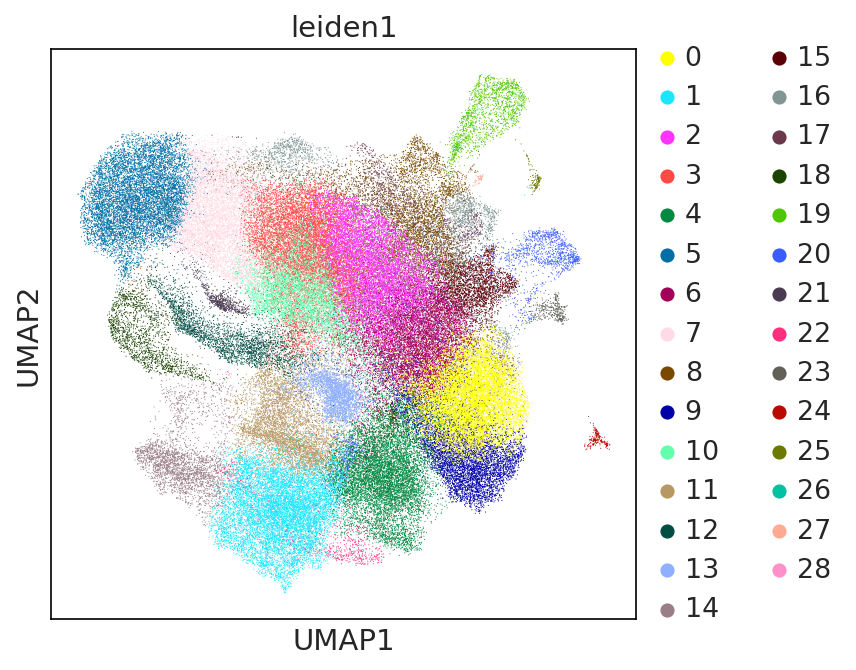

In [79]:
sc.pl.umap(adata,color='leiden1')

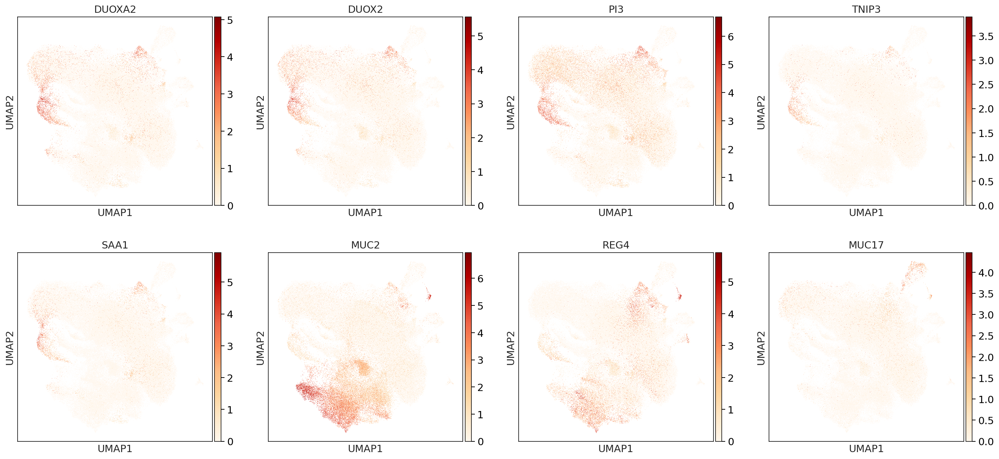

In [80]:
sc.pl.umap(adata,color=['DUOXA2','DUOX2','PI3','TNIP3','SAA1','MUC2','REG4','MUC17'],cmap='OrRd')

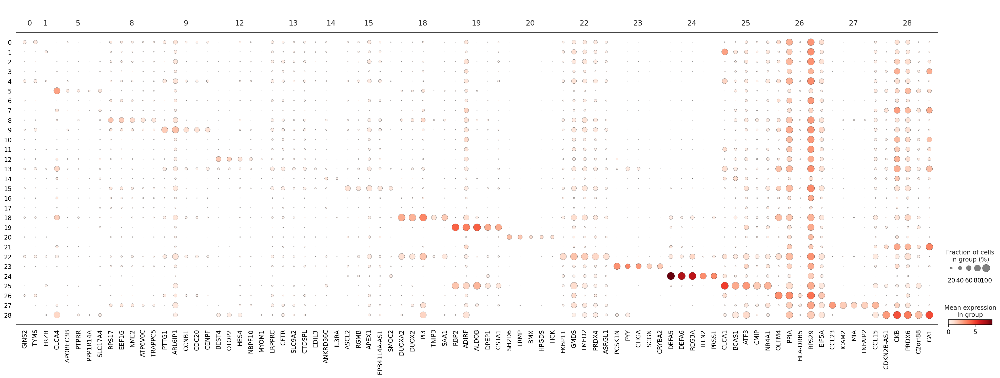

In [81]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden1")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden1', mks=mks)

Cluster 18 and 19 are expressing DCS and enterocyte markers (respectively), what are these clusters?

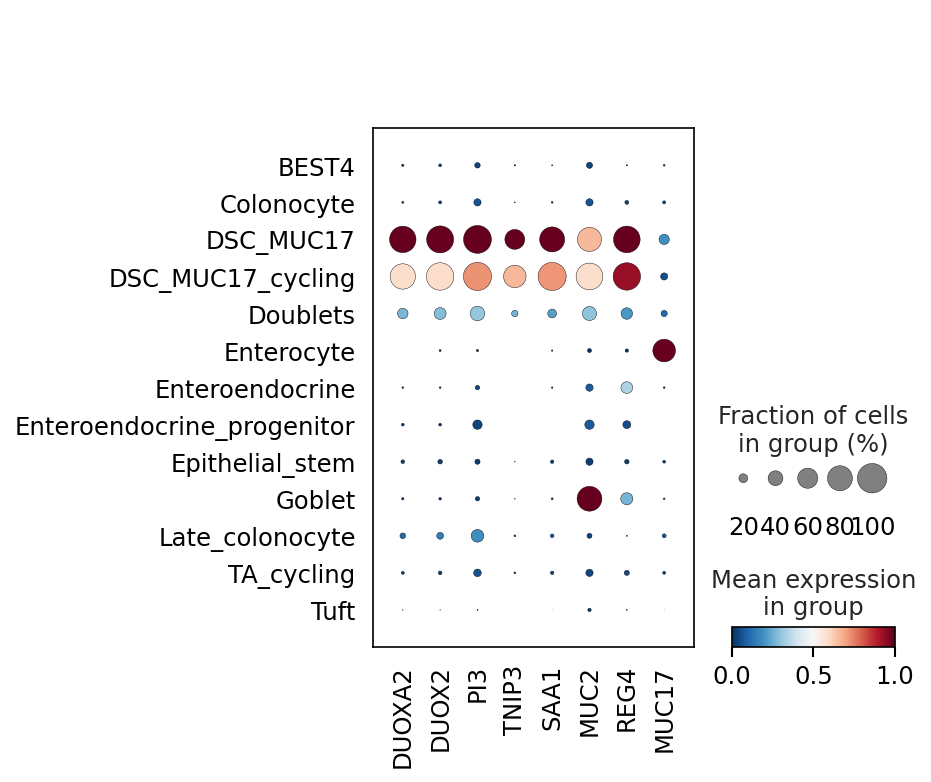

In [82]:
sc.pl.dotplot(adata,var_names=['DUOXA2','DUOX2','PI3','TNIP3','SAA1','MUC2','REG4','MUC17'],groupby='fine_predicted_labels',color_map='RdBu_r', standard_scale='var')

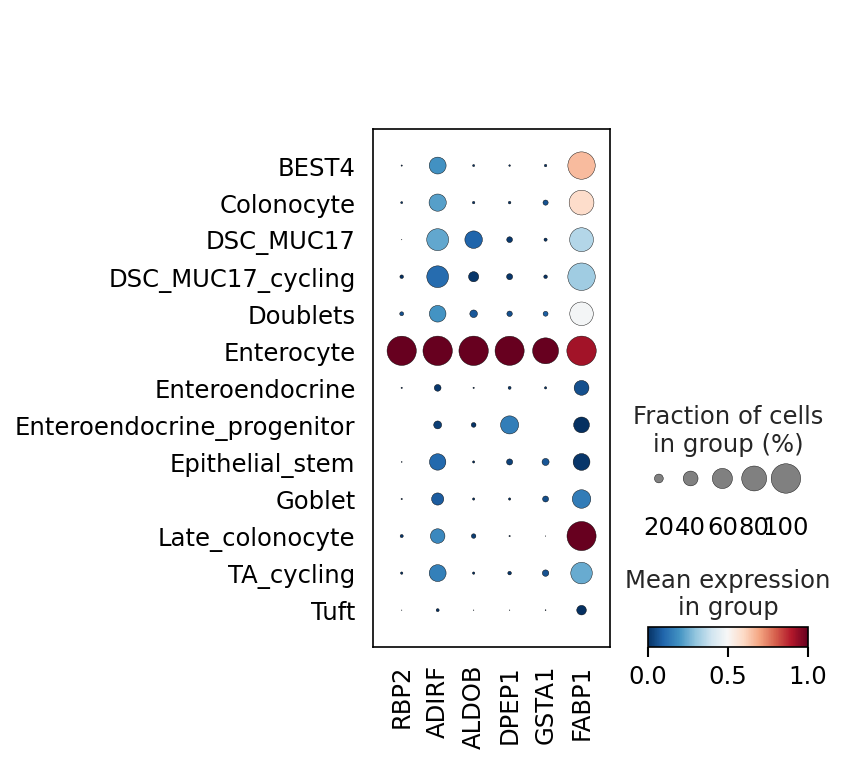

In [83]:
sc.pl.dotplot(adata,var_names=['RBP2','ADIRF','ALDOB','DPEP1','GSTA1','FABP1'],groupby='fine_predicted_labels',color_map='RdBu_r', standard_scale='var')

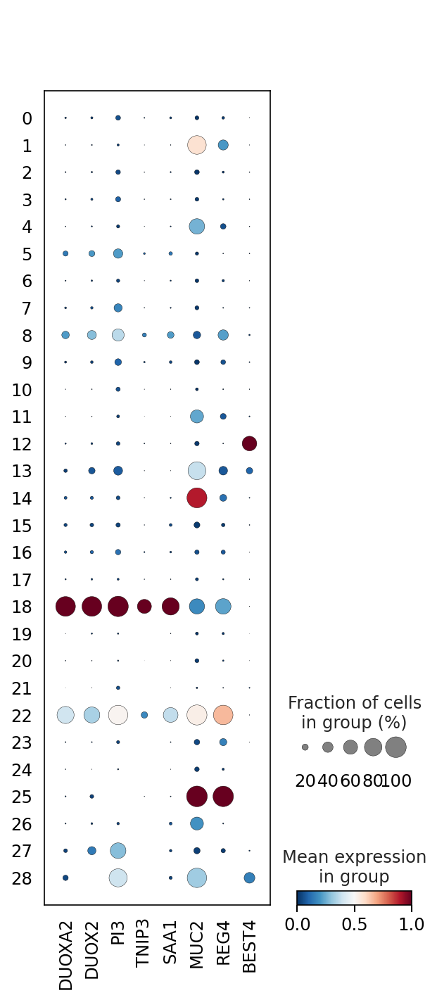

In [84]:
sc.pl.dotplot(adata,var_names=['DUOXA2','DUOX2','PI3','TNIP3','SAA1','MUC2','REG4','BEST4'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

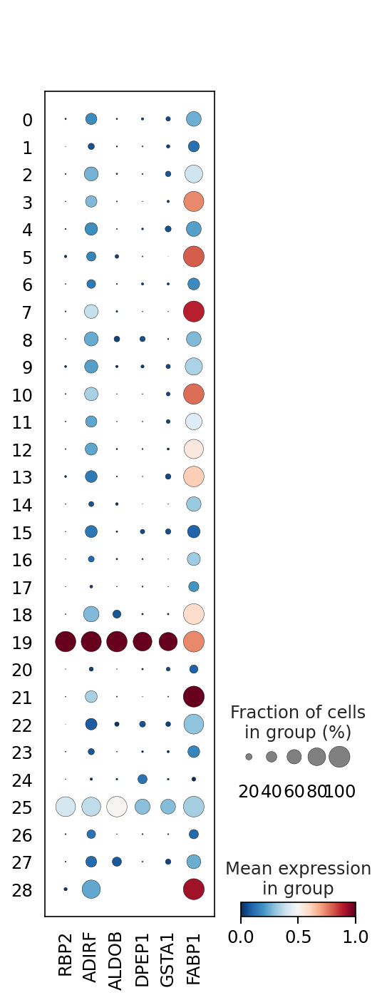

In [85]:
sc.pl.dotplot(adata,var_names=['RBP2','ADIRF','ALDOB','DPEP1','GSTA1','FABP1'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

In [86]:
adata.obs.organ_unified.value_counts()

colon               37874
ascending colon     35706
descending colon    21941
sigmoid colon        9120
caecum               6143
transverse           4402
rectum                917
Name: organ_unified, dtype: int64

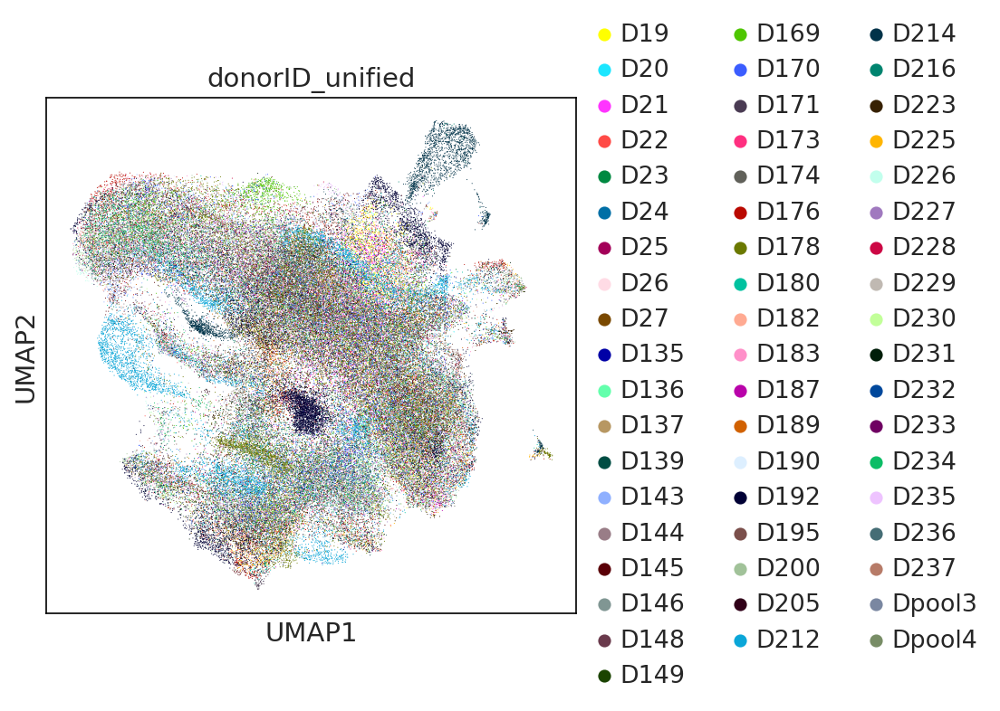

In [87]:
sc.pl.umap(adata,color='donorID_unified')

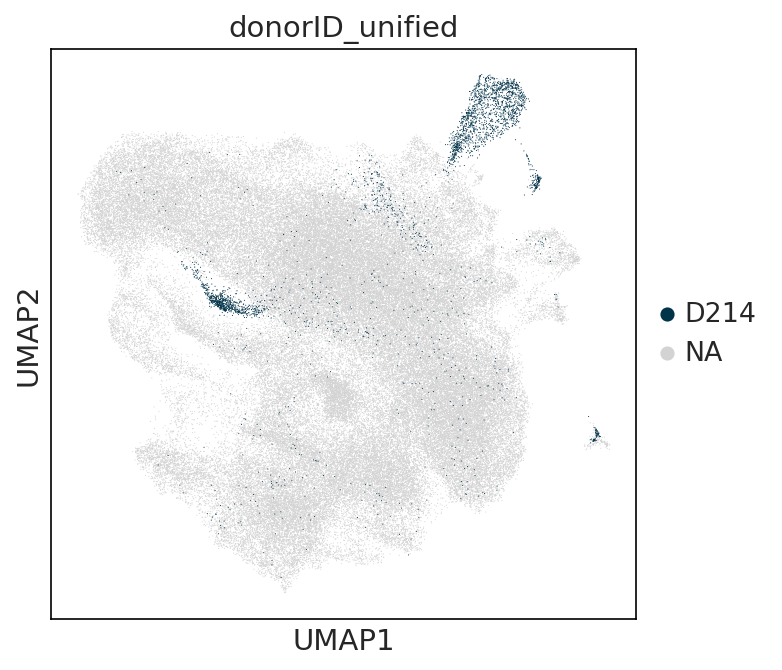

In [88]:
sc.pl.umap(adata,color='donorID_unified',groups='D214')

Ok these clusters are donor specific - donors 212 and 214

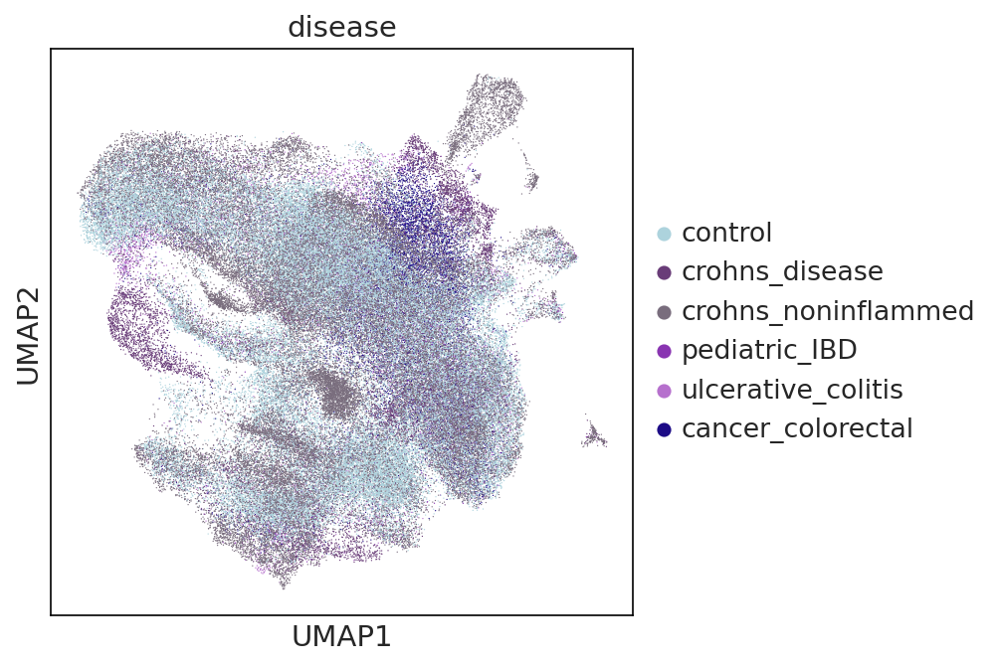

In [89]:
sc.pl.umap(adata,color='disease',size=1.5)

In [143]:
adata.obs['study_donor'] = adata.obs['study'].astype(str) + '_' + adata.obs['donorID_unified'].astype(str)

In [144]:
adata.obs.study_donor.value_counts()

Kong2023_D178       10929
Kong2023_D223        9098
Kong2023_D212        8103
Kong2023_D192        7786
Kong2023_D226        4547
Kong2023_D229        4363
Kong2023_D176        4363
Kong2023_D216        4061
Kong2023_D227        3672
Parikh2019_D145      3387
Kong2023_D214        3241
Kong2023_D190        3087
Kong2023_D234        2991
Kong2023_D170        2945
Lee2020_D21          2548
Kong2023_D236        2417
Kong2023_D232        2364
Lee2020_D19          2350
Kong2023_D235        2143
Kong2023_D231        2038
Kong2023_D230        1984
Kong2023_D169        1940
Kong2023_D189        1812
Kong2023_D225        1751
Kong2023_D183        1683
Kong2023_D233        1515
Lee2020_D22          1436
Kong2023_D200        1376
Parikh2019_D144      1371
Lee2020_D26          1335
Kong2023_D205        1316
Kong2023_D228        1216
Parikh2019_D143       959
Lee2020_D20           917
Lee2020_D25           880
Huang2019_Dpool3      867
Kong2023_D182         857
Kong2023_D187         838
Lee2020_D27 

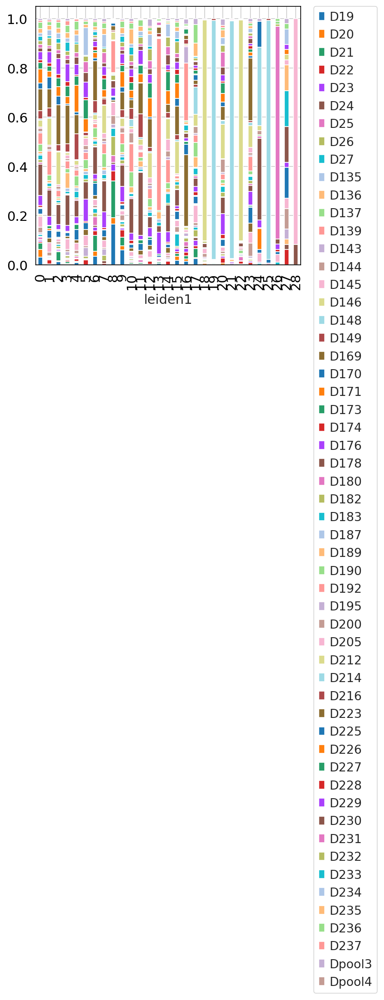

In [90]:
#Extended data 5g
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

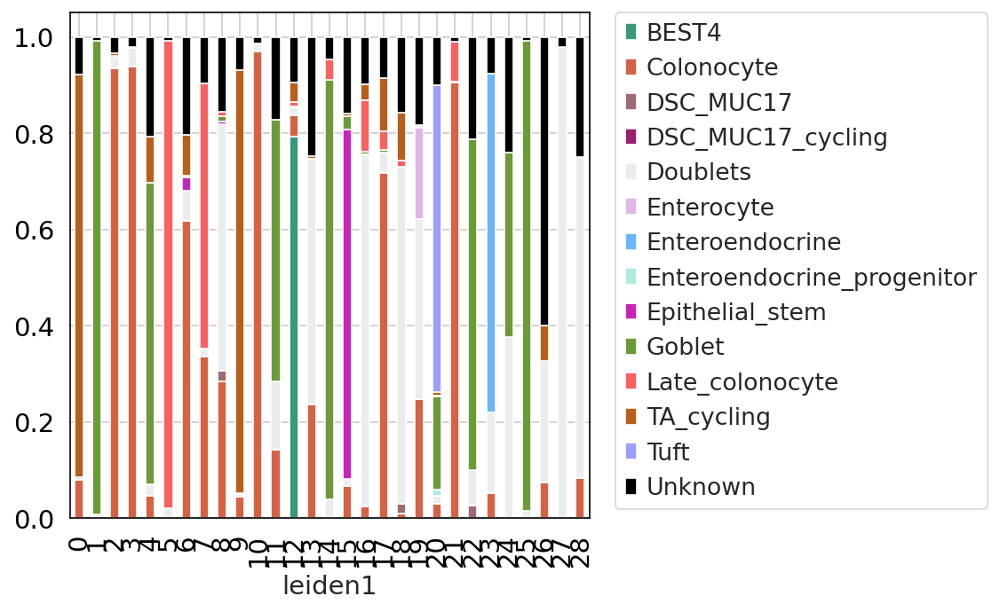

In [91]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['fine_predicted_labels_uncertflagged'],normalize='index'
                                                                         )
ax = tmp.plot.bar(stacked=True,color=['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                 '#ebeded',#doublets
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               #'#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
                                                          '#000000',#unknown
                                                                         ])
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

plt.savefig("Epi_LI_disease_celltypes_celltype_per_leidencluster_reannotation.pdf", dpi=300, bbox_inches='tight')

In [92]:
pd.crosstab(adata.obs.donorID_unified,adata.obs.leiden1)

leiden1,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,25,26,27,28
donorID_unified,,,,,,,,,,,,,,,,,,,,,
D19,319,21,125,28,72,0,282,2,980,332,...,5,1,0,2,0,0,0,0,0,0
D20,316,12,26,23,16,0,170,0,154,90,...,0,9,0,0,0,0,0,0,0,0
D21,255,5,355,64,36,0,515,0,892,198,...,8,1,0,0,0,0,0,0,0,0
D22,69,168,48,51,81,176,153,37,233,162,...,0,30,0,7,4,0,0,0,3,0
D23,57,40,43,28,22,8,125,3,170,39,...,1,11,0,0,2,0,0,0,0,0
D24,24,9,14,30,6,30,58,61,42,7,...,0,0,0,1,1,0,0,0,1,0
D25,106,15,33,36,62,0,280,0,164,23,...,1,2,0,11,0,0,0,0,0,0
D26,32,30,82,73,50,83,126,142,456,56,...,0,11,0,2,2,0,0,0,0,0
D27,76,34,69,16,43,0,139,3,203,58,...,1,3,0,0,0,1,0,1,0,0


In [97]:
adata

AnnData object with n_obs × n_vars = 116103 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [98]:
del adata.uns['organ_unified_colors']

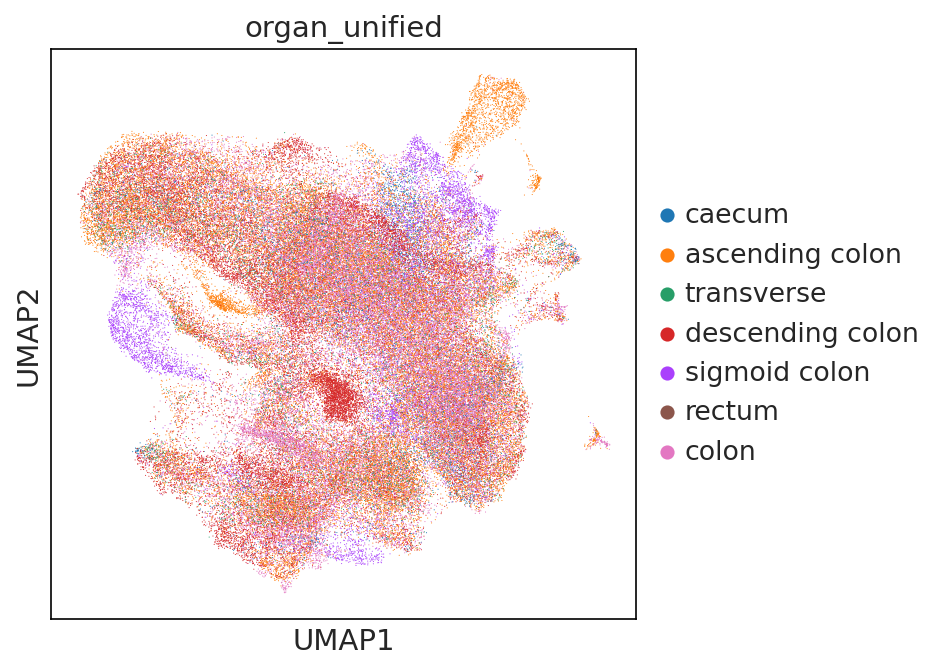

In [99]:
sc.pl.umap(adata,color='organ_unified')

In [100]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,BEST4,Colonocyte,DSC_MUC17,DSC_MUC17_cycling,Doublets,Enterocyte,Enteroendocrine,Enteroendocrine_progenitor,Epithelial_stem,Goblet,Late_colonocyte,TA_cycling,Tuft,Unknown
leiden1,,,,,,,,,,,,,,
0,0,804,0,0,54,0,0,0,8,1,0,8460,0,788
1,0,21,0,0,50,0,0,0,1,9749,0,0,0,73
2,2,8952,0,0,201,0,0,0,39,0,0,48,0,334
3,3,8594,0,0,353,0,0,0,0,0,9,0,0,200
4,1,398,0,0,205,0,0,0,0,5398,0,824,0,1789
5,5,0,0,0,171,0,0,0,0,0,8307,0,0,76
6,0,5014,0,0,511,0,0,0,225,26,0,687,0,1650
7,3,2166,0,0,116,0,0,0,0,0,3560,0,0,626
8,7,1675,138,1,3038,0,0,0,28,71,49,7,0,918


In [101]:
unknown['fine_predicted_labels_resolved'] = (unknown['leiden1']
        .map(lambda x:{'0':'TA_cycling',
                       '1':'Goblet',
                       '2':'Colonocyte',
                       '3':'Colonocyte',
                       '4':'Goblet',
                       '5':'Late_colonocyte', 
                       '6':'Colonocyte',
                       '7':'Late_colonocyte',
                       '8':'Doublets', 
                       '9':'TA_cycling',
                       '10':'Colonocyte',
                       '11':'Goblet',
                       '12':'BEST4',
                       '13':'Doublets',
                       '14':'Goblet',
                       '15':'Epithelial_stem',
                       '16':'Doublets',
                       '17':'Colonocyte',
                       '18':'Doublets', #from only one donor, majority voting is doublets so I'll keep it this way to exclude
                       '19':'Doublets', # expresses enterocyte markers but mainly from one donor ascending colon, could be real contaminating enterocytes? Exclude anyway
                       '20':'Tuft',
                       '21':'Colonocyte',
                       '22':'Goblet',
                       '23':'Enteroendocrine',
                       '24':'Paneth', 
                       '25':'Goblet',
                       '26':'Doublets', #this cluster is also mostly coming from one donor, rest of cells are annotated as doublets anyway
                       '27':'Doublets', 
                       '28':'Doublets'
                         }.get(x,x)).astype('category'))

In [102]:
unknown

,leiden1,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,,
AAACCTGGTCTTTCAT-scrEXT001,4,Unknown,Goblet
AAAGATGGTATAGGGC-scrEXT001,8,Unknown,Doublets
AAAGCAAGTAAACACA-scrEXT001,6,Unknown,Colonocyte
AAATGCCCACAGTCGC-scrEXT001,8,Unknown,Doublets
AAATGCCTCAAACCAC-scrEXT001,16,Unknown,Doublets
...,...,...,...
N130084_L-TCTTAGTAGATCCCAT-N130084_L,2,Unknown,Colonocyte
N130084_L-GTCGTAAGTAGCGTCC-N130084_L,12,Unknown,BEST4
N130084_L-CGGAGAATCTCTTGCG-N130084_L,6,Unknown,Colonocyte


In [103]:
adata

AnnData object with n_obs × n_vars = 116103 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

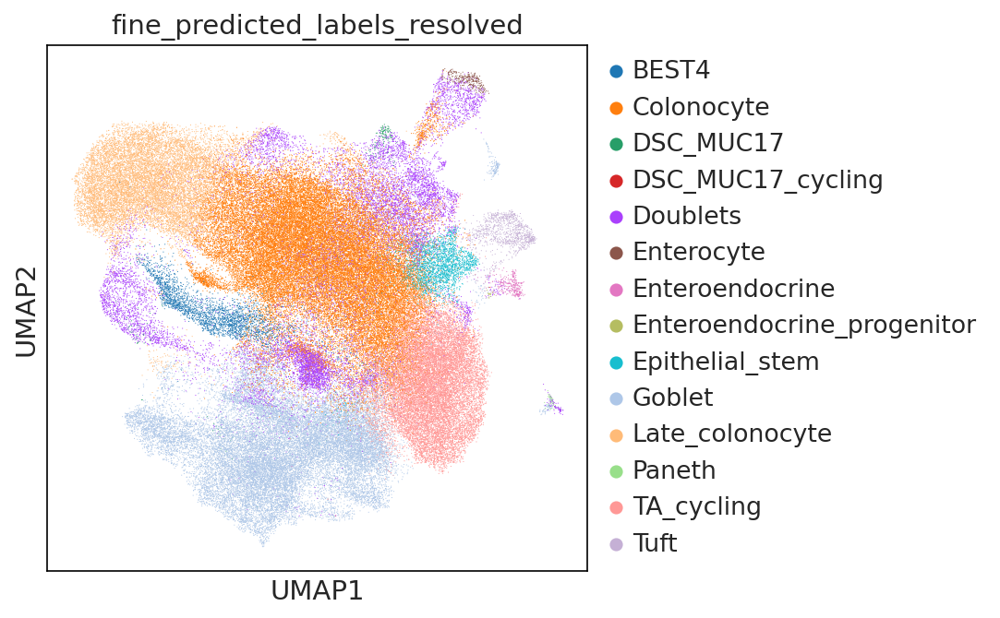

In [104]:
ON = {O:N for O,N in zip(unknown.index,unknown["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

In [105]:
paneth = adata[adata.obs.leiden1.isin(['24'])].copy()

In [106]:
paneth.obs['fine_predicted_labels_resolved'] = (paneth.obs['leiden1']
        .map(lambda x:{'24':'Paneth'
                         }.get(x,x)).astype('category'))

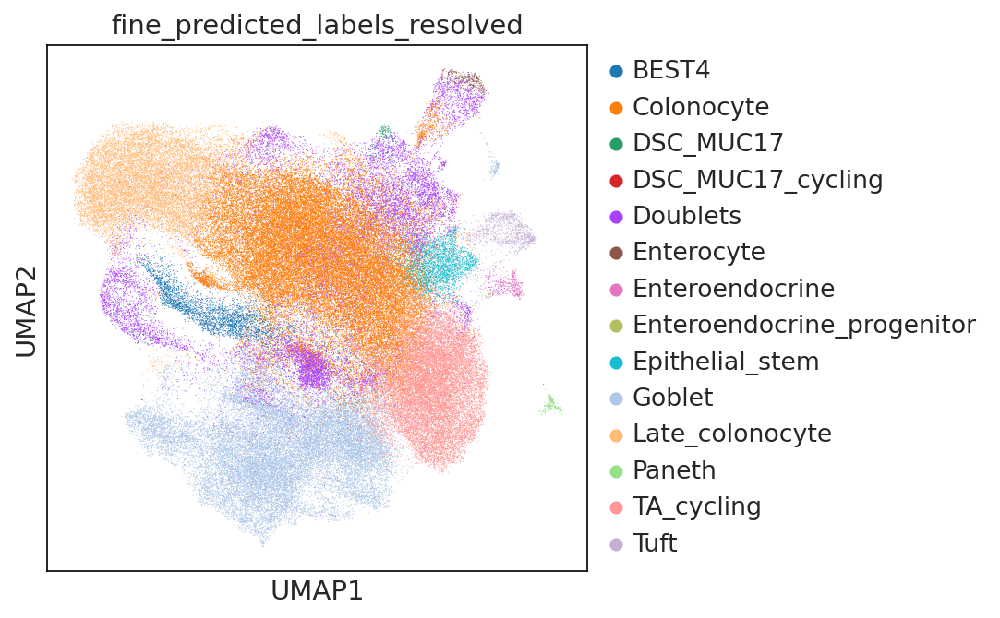

In [107]:
ON = {O:N for O,N in zip(paneth.obs_names,paneth.obs["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_resolved"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

In [108]:
paneth.obs.disease.value_counts()

crohns_noninflammed    160
crohns_disease          20
ulcerative_colitis       8
pediatric_IBD            2
cancer_colorectal        1
Name: disease, dtype: int64

In [109]:
paneth.obs.donorID_unified.value_counts()

D178      63
D214      61
D225      20
D171      16
D145       7
D176       6
D212       4
D170       3
D200       3
D180       2
Dpool3     2
D27        1
D135       1
D174       1
D190       1
Name: donorID_unified, dtype: int64

# Now also exlude clusters with overrepresentation of one donor

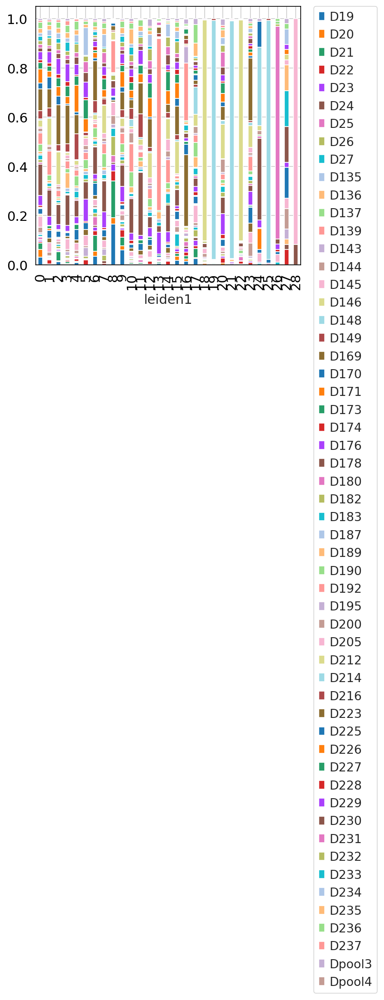

In [110]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

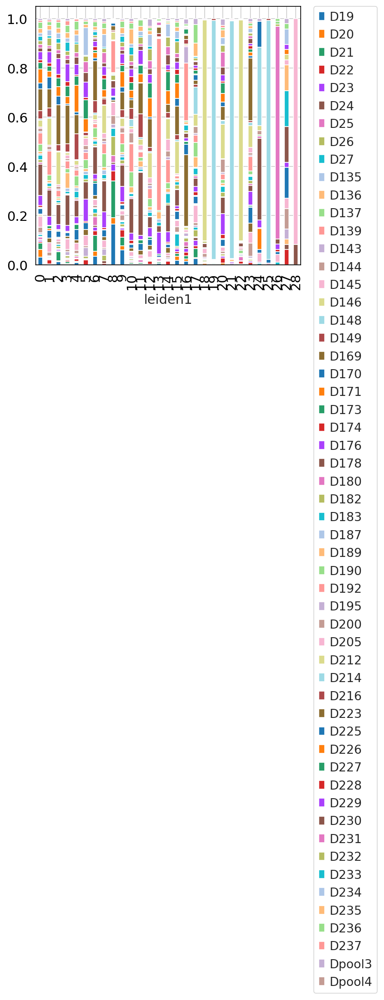

In [119]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
ax = tmp.plot.bar(stacked=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig("Epi_LI_disease_celltypes_leidenvsdonorID.pdf", dpi=300, bbox_inches='tight')

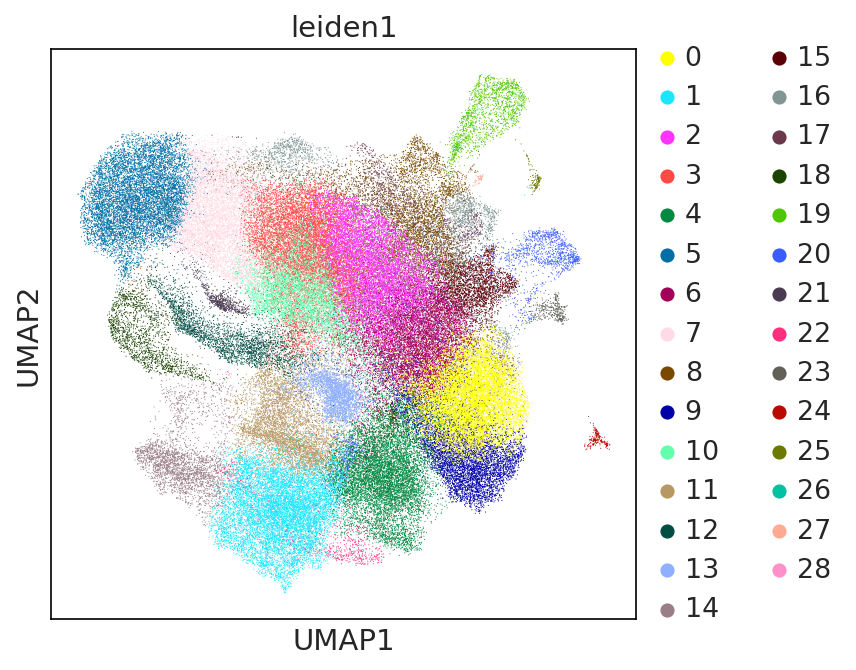

In [111]:
sc.pl.umap(adata,color='leiden1')

In [112]:
adata.obs.leiden1.dtype

CategoricalDtype(categories=['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
                  '12', '13', '14', '15', '16', '17', '18', '19', '20', '21',
                  '22', '23', '24', '25', '26', '27', '28'],
, ordered=False)

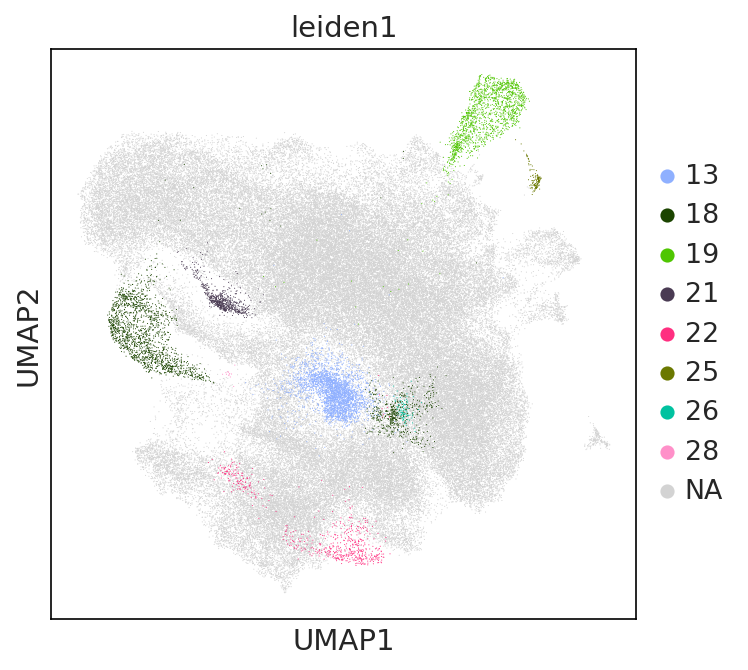

In [113]:
sc.pl.umap(adata,color='leiden1',groups=['13','18','19','21','22','25','26','28'])

In [114]:
donor_specific = adata[adata.obs.leiden1.isin(['13','18','19','21','22','25','26','28'])].copy()

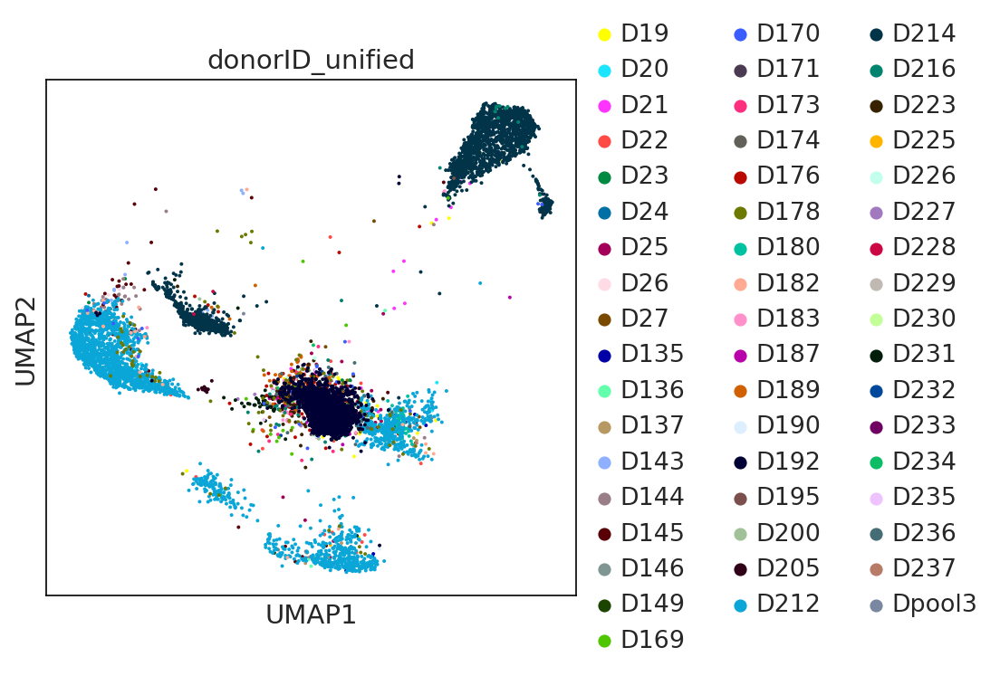

In [115]:
sc.pl.umap(donor_specific,color='donorID_unified')

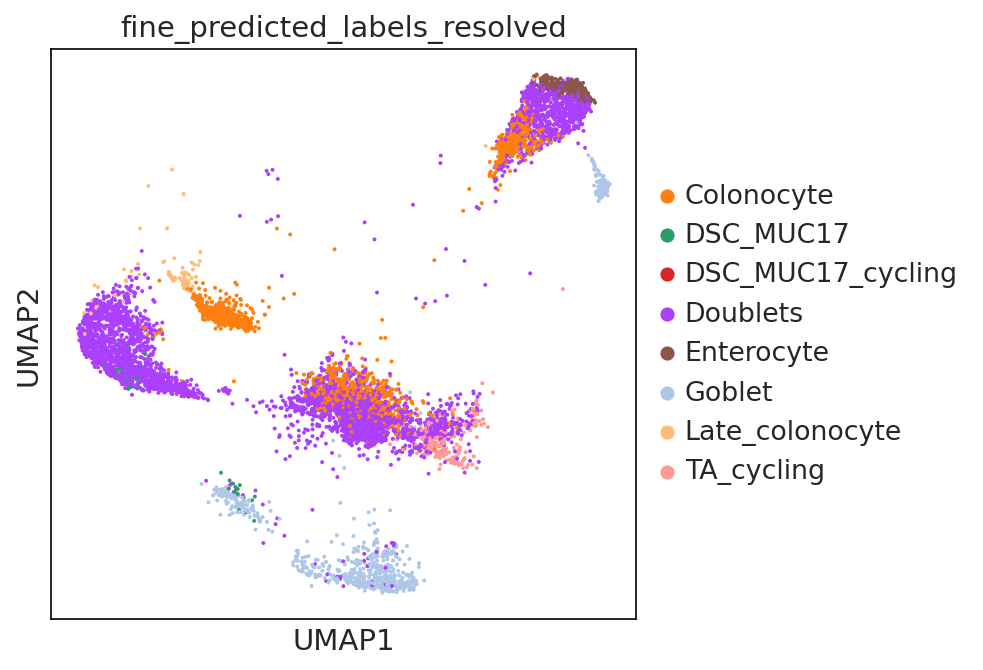

In [116]:
sc.pl.umap(donor_specific,color='fine_predicted_labels_resolved')

In [117]:
#remove 13 from the list
donor_specific = adata[adata.obs.leiden1.isin(['18','19','21','22','25','26','28'])].copy()

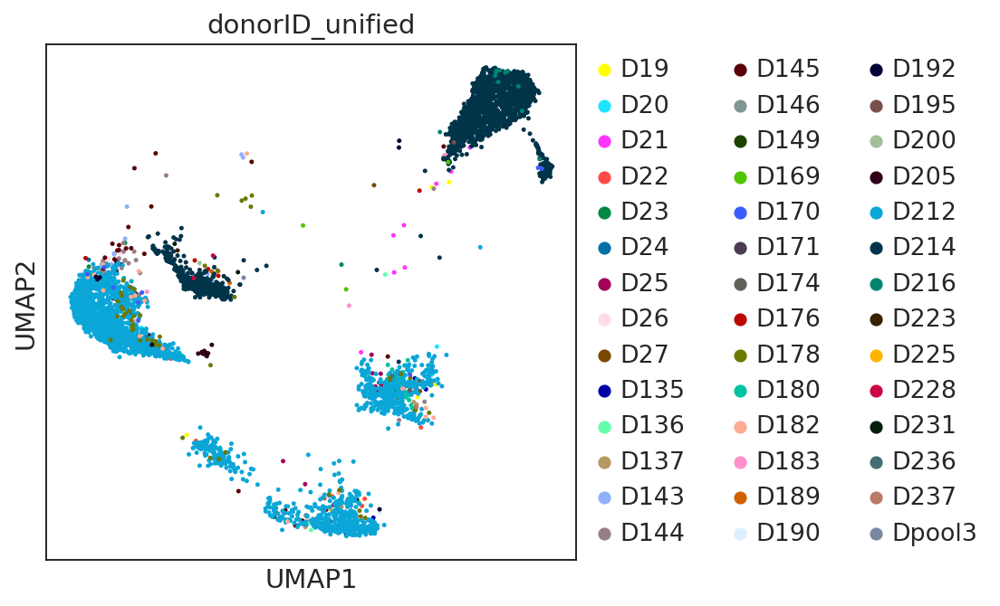

In [118]:
sc.pl.umap(donor_specific,color='donorID_unified')

In [121]:
donor_specific.obs['fine_predicted_labels_resolved'] = (donor_specific.obs['leiden1']
        .map(lambda x:{'18':'Donor_specific',
                       '19':'Donor_specific',
                       '21':'Donor_specific',
                       '22':'Donor_specific',
                       '25':'Donor_specific',
                       '26':'Donor_specific',
                       '28':'Donor_specific'
                         }.get(x,x)).astype('category'))

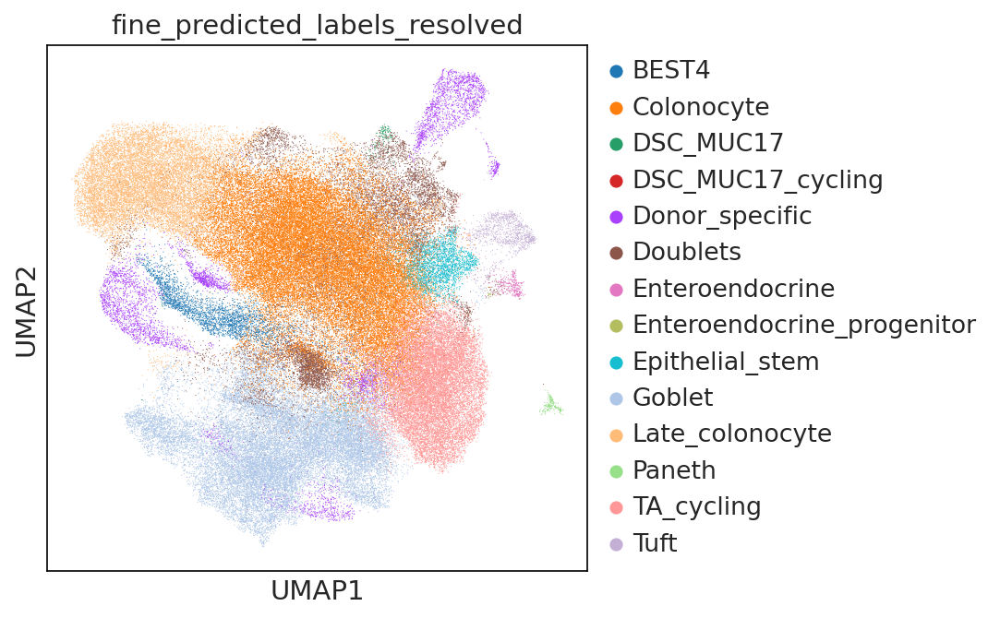

In [122]:
ON = {O:N for O,N in zip(donor_specific.obs_names,donor_specific.obs["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_resolved"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

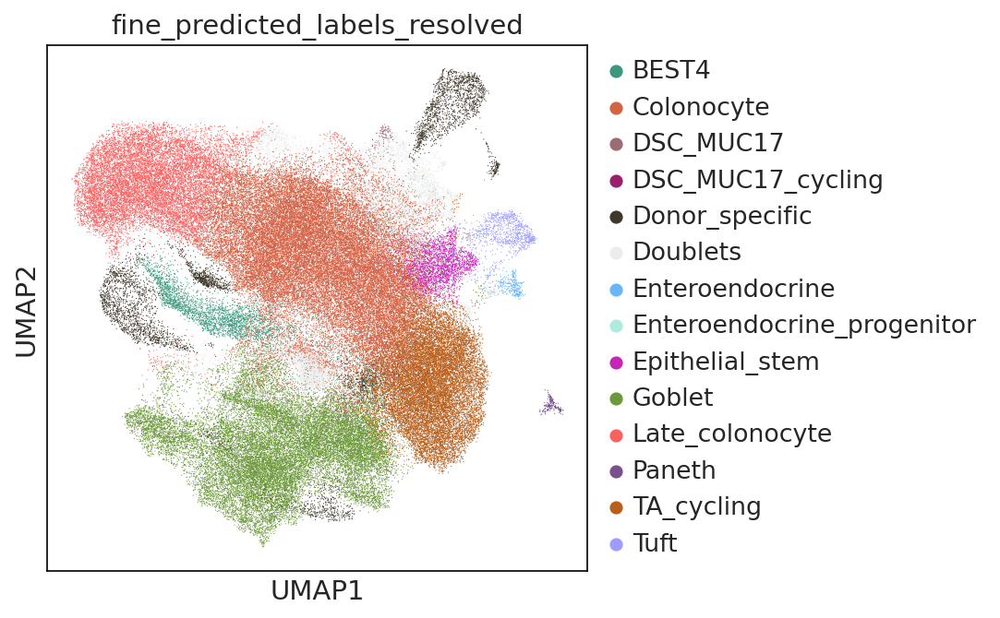

In [124]:
#Extended data 5h
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color=['fine_predicted_labels_resolved'], palette=['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                                    '#40372a',#donorspecific
                                                 '#ebeded',#doublets
                                               #'#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               '#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft 
    
                                              ],size=1.2,save='Epi_LI_disease_final_annot_updateJuly23.pdf')

In [136]:
clean = adata[~adata.obs.fine_predicted_labels_resolved.isin(['Donor_specific','Doublets'])].copy()

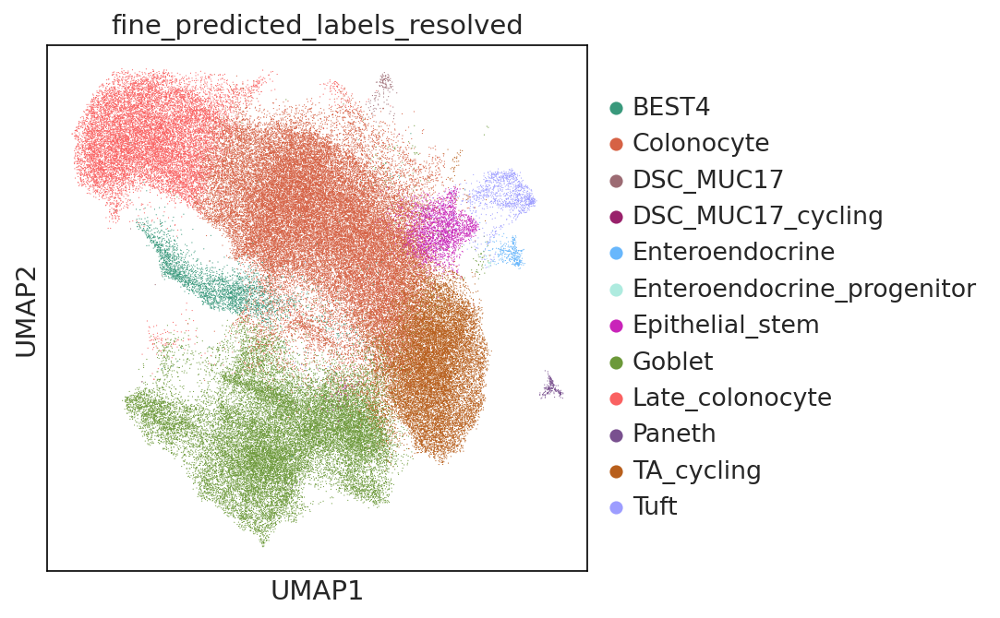

In [138]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(clean,color=['fine_predicted_labels_resolved'], palette=['#39997c',#BEST4
                                                 
                                               '#d66245',#Colonocyte
                                               '#9c6b73',#DSC_MUC17
                                               '#99216b',#DSC_MUC17 cycling
                                                                    #'#40372a',#donorspecific
                                                 #'#ebeded',#doublets
                                               #'#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                 '#aeebdf',#enteroendocrine progenitor
                                                 
                                                
                                               '#c924b9',#stem
                                               '#6c9939',#goblet
                                               #'#d1d14f',#goblet_cycling
                                               #'#e9f7ad',#goblet progenitor
                                               
                                               '#fa6161',#late colonocyte
                                              #'#d9b74a',#MUC5AC
                                               #'#f7b37c',#MUC6
                                               
                                               #'#e55b85',#Microfold
                                               '#79508f',#paneth
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft 
    
                                              ],size=1.2,save='Epi_LI_disease_final_annot_updateJuly23_clean.pdf')

In [127]:
marker_genes_dict = { 'BEST4':['BEST4','CA7','GUCA2B','CFTR'],
                     'Colonocyte':['CA1','GPT'],
                     
                     'DCS_MUC17':['MUC17','TFF1','CD55','TM4SF1','DUOX2','DUOXA2'],
                     'Cycling markers':['MKI67','PCNA','TOP2A'],
                        #'Enterocyte':['FABP1','APOA4','PRAP1','PCK1','RBP2','SI'],
                     'Enteroendocrine':['CHGA','PCSK1N','SCT','SCGN','NEUROD1','SOX4'],
                     'Stem':['LGR5','RGMB','ASCL2','OLFM4'],
                     
                     
                     'Goblet':['MUC2','TFF3','FCGBP','ZG16'],
                     'Mature_colonocyte':['SLC26A3','AQP8','CEACAM7'],
                      #'MUC5AC':['MUC5AC','GKN2'],
                     #'MUC6':['MUC6','AQP5','BPIFB1','PGC'],
                    # 'Microfold':['IL2RG','ICAM2','CCL20','CCL23'],
                     'Paneth':['DEFA6','DEFA5','REG3A','PLA2G2A'],
                     
                     'Tuft':['SH2D6','LRMP','MATK','HPGDS']
                     }

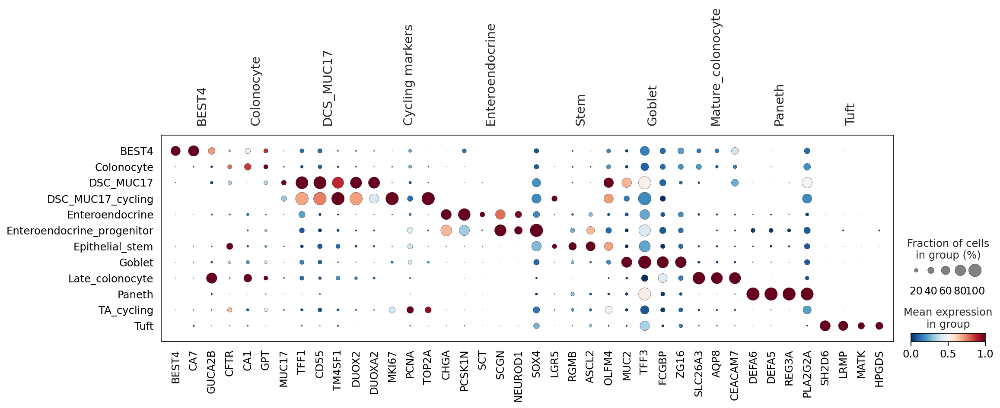

In [128]:
#Extended data 5i
sc.pl.dotplot(clean,var_names=marker_genes_dict,groupby='fine_predicted_labels_resolved',color_map='RdBu_r', standard_scale='var',save='Epi_LI_disease_leiden_reannotationmarkergenedotplot_clean.pdf')

In [129]:
adata.obs.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/final_annot_post_scanvi/Epi_LI_disease_metadata_update20230706.csv')

In [140]:
sc.pp.neighbors(clean, use_rep="X_scANVI")
sc.tl.umap(clean)

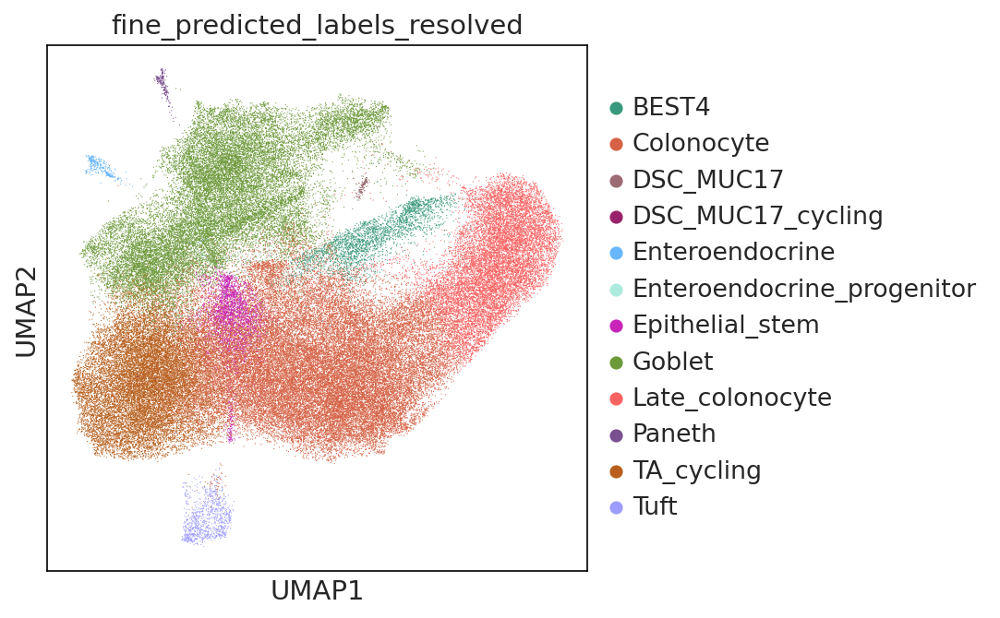

In [141]:
sc.pl.umap(clean,color='fine_predicted_labels_resolved')

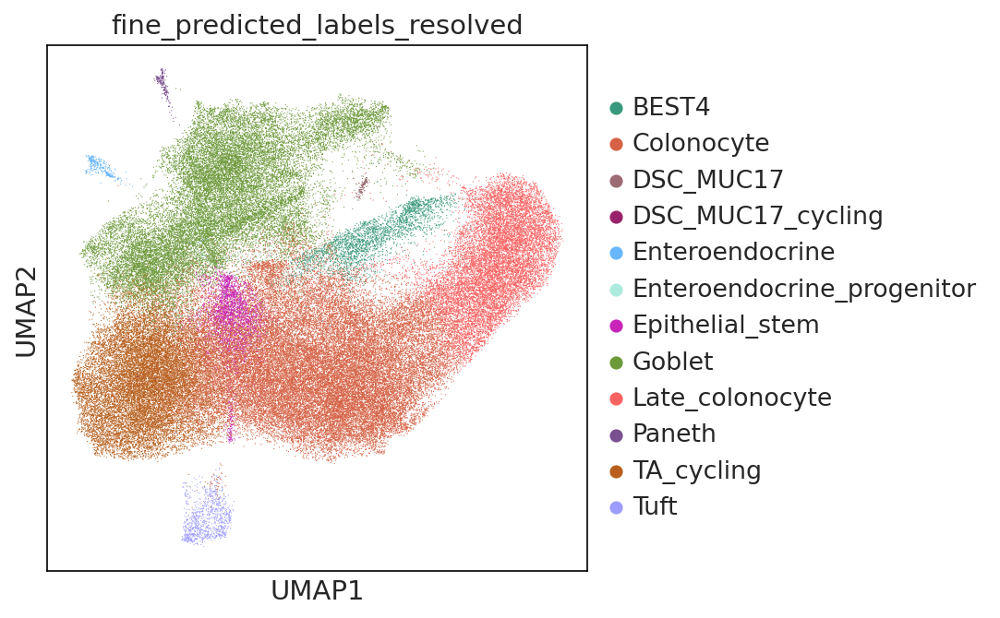

In [142]:
sc.pl.umap(clean,color='fine_predicted_labels_resolved',save='Epi_LI_final_July23_clean.pdf')

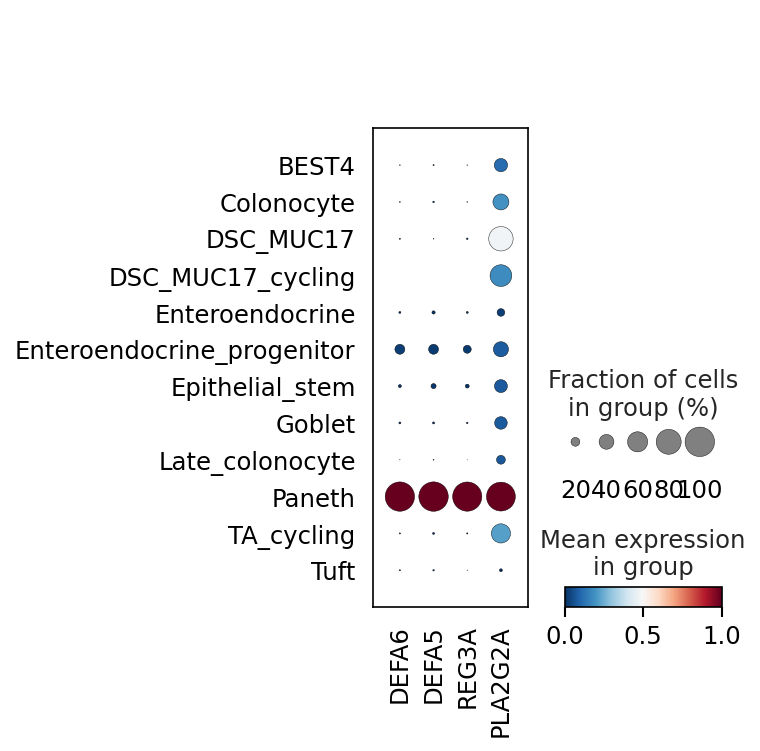

In [132]:
sc.pl.dotplot(clean,var_names=['DEFA6','DEFA5','REG3A','PLA2G2A'],groupby='fine_predicted_labels_resolved',color_map='RdBu_r', standard_scale='var',save='Epi_LI_disease_final_annot_paneth_dotplot.pdf')

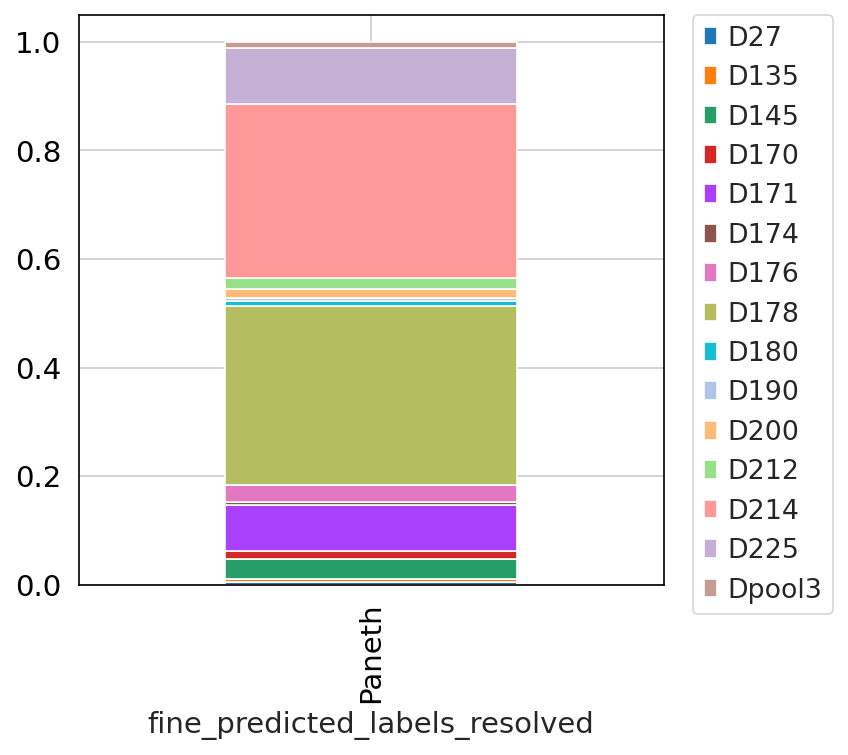

In [133]:
tmp = pd.crosstab(paneth.obs['fine_predicted_labels_resolved'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
ax = tmp.plot.bar(stacked=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig("Epi_LI_disease_paneth_donorbreakdown.pdf", dpi=300, bbox_inches='tight')

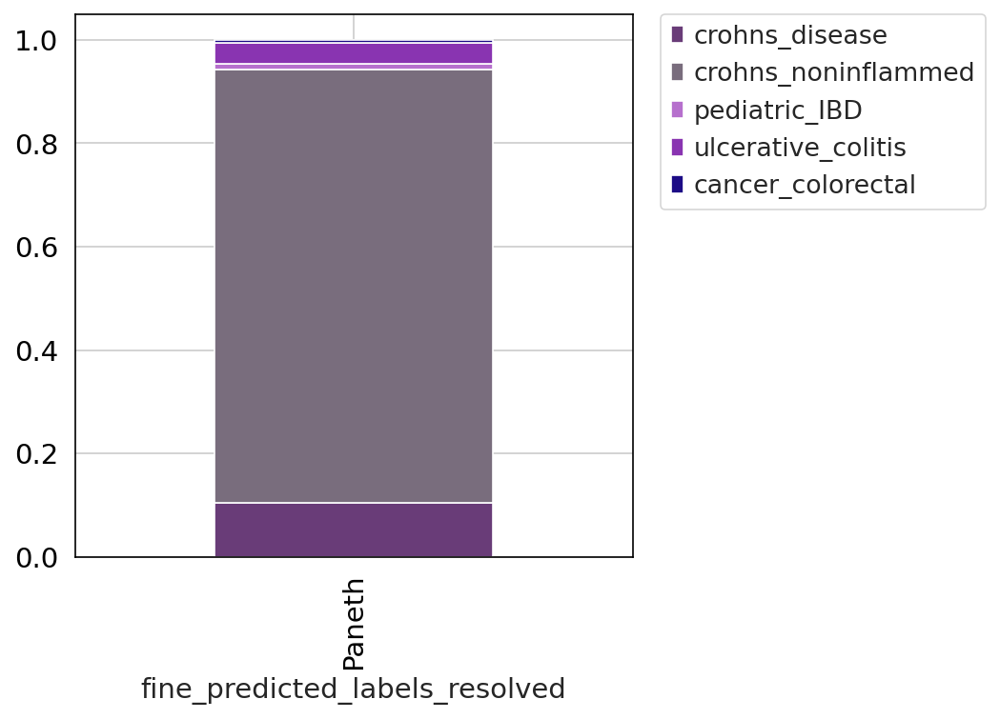

In [134]:
tmp = pd.crosstab(paneth.obs['fine_predicted_labels_resolved'], adata.obs['disease'],normalize='index'
                                                                         )
ax = tmp.plot.bar(stacked=True,color=[ '#693C78',#crohn's disease
                                            '#796d7d',#crohns noninflammed
                                            
                                            '#B670CD',#PIBD
                                      '#8934B1',#UC
                                            '#1C0B86',#colorectal cancer
                                     ])
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig("Epi_LI_disease_paneth_diseasebreakdown.pdf", dpi=300, bbox_inches='tight')